In [1]:
import os
import numpy as np
import glob
from tqdm import tqdm
import copy
from skimage.feature import canny
from skimage.transform import resize
import pandas as pd
import seaborn as sns
import nibabel as nib
# from torchinfo import summary

import torch
import torch.nn as nn
from torch.utils.data import DataLoader
import torchio as tio
import networks_gan
import losses
from skimage.metrics import structural_similarity as ssim
from dataloader import RadOncTrainingDataset, RadOncValidationDataset, headscanner_training_dataset, headscanner_validation_dataset
import surface_distance
from helpers import compute_surface_metrics, compute_TRE
os.environ['VXM_BACKEND'] = 'pytorch'
import voxelmorph as vxm  # nopep8

import matplotlib.pyplot as plt
from matplotlib import colors as mplcolors
from matplotlib.collections import LineCollection
def colormap_binary(fg, bg=(0,0,0), alpha=None):
    fg = mplcolors.to_rgb(fg)
    bg = mplcolors.to_rgb(bg)
    cmap = mplcolors.LinearSegmentedColormap.from_list('Binary', (bg,fg), 256)
    if alpha is not None:
        cmap._init()
        cmap._lut[:,-1] = np.linspace(0, alpha, cmap.N+3)
    return cmap
from mpl_toolkits.axes_grid1 import make_axes_locatable
plt.style.use('dark_background')

2023-07-10 14:28:12.332839: I tensorflow/core/platform/cpu_feature_guard.cc:193] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 AVX512F AVX512_VNNI FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.
2023-07-10 14:28:12.531277: I tensorflow/core/util/port.cc:104] oneDNN custom operations are on. You may see slightly different numerical results due to floating-point round-off errors from different computation orders. To turn them off, set the environment variable `TF_ENABLE_ONEDNN_OPTS=0`.
2023-07-10 14:28:12.535124: W tensorflow/compiler/xla/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libcudart.so.11.0'; dlerror: libcudart.so.11.0: cannot open shared object file: No such file or directory
2023-07-10 14:28:12.535137: I tensorflow/compiler/xla/stream_executor/cuda/cudart_stub.cc:29] Ignore 

In [2]:
valid_dataset = RadOncValidationDataset("/mnt/blackhole-data2/RadOnc_Brain/Validation", num_samples=None, supervision=True,
                                            return_segmentation=True)

In [3]:
device = torch.device('cpu')

/home/myi16/anaconda3/envs/jsr_Y/lib/python3.9/site-packages/torch/functional.py:478: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at  ../aten/src/ATen/native/TensorShape.cpp:2895.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]
  0%|          | 0/10 [00:00<?, ?it/s]

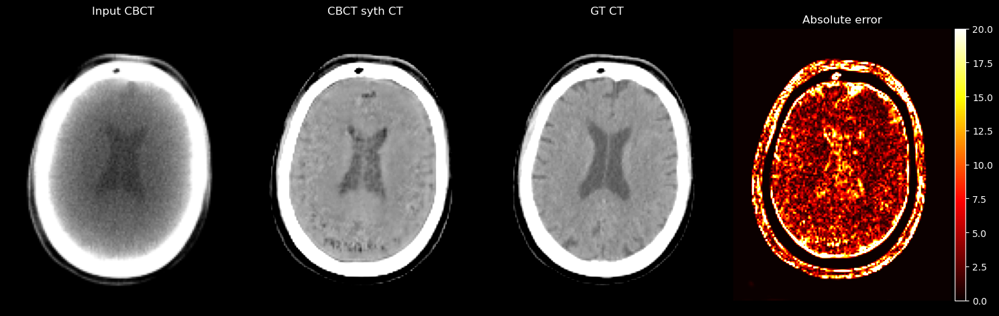

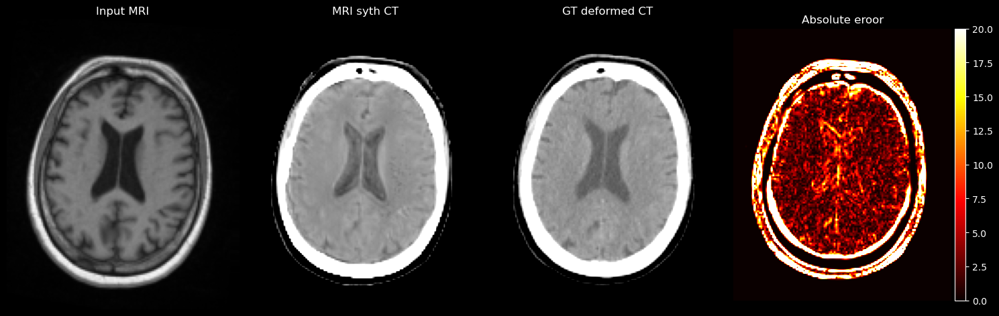

 10%|█         | 1/10 [00:16<02:29, 16.61s/it]

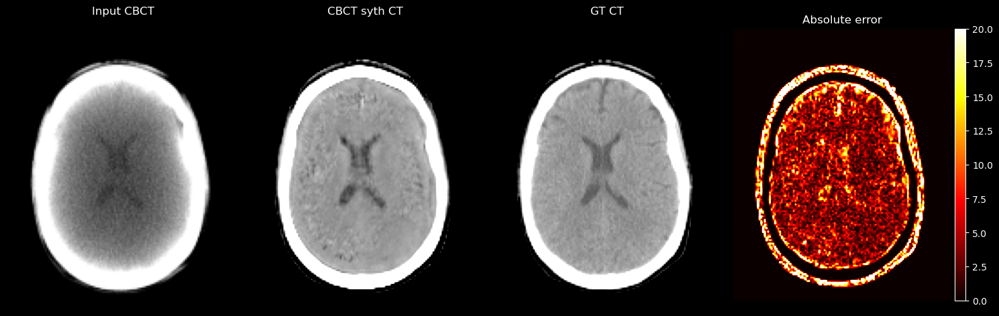

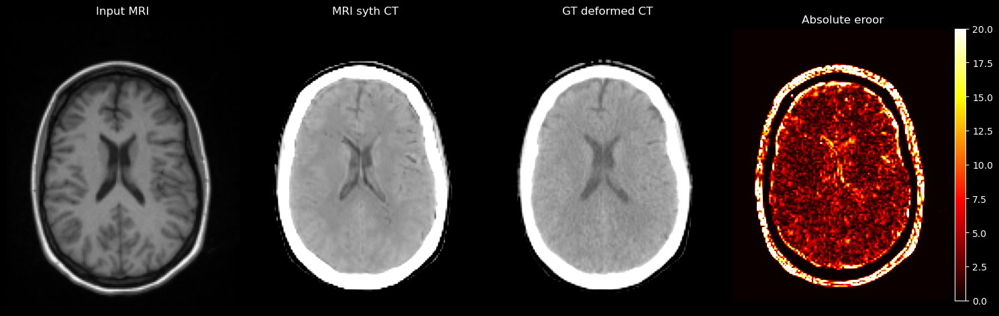

 20%|██        | 2/10 [00:32<02:08, 16.09s/it]

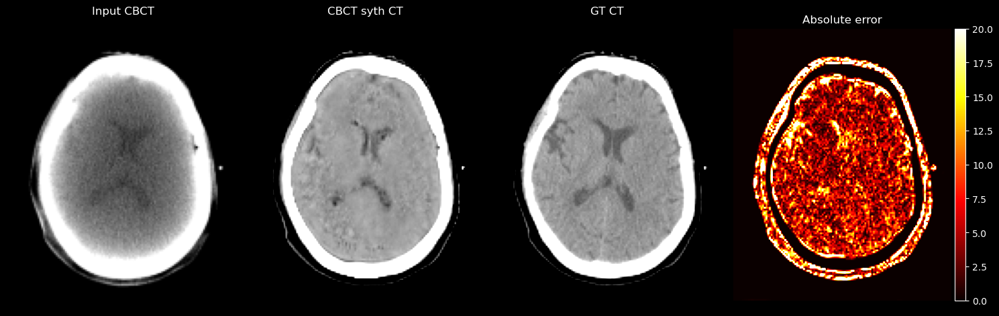

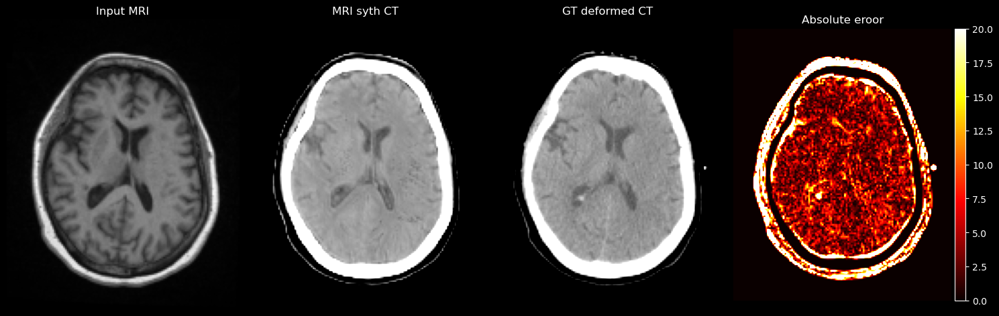

 30%|███       | 3/10 [00:48<01:52, 16.04s/it]

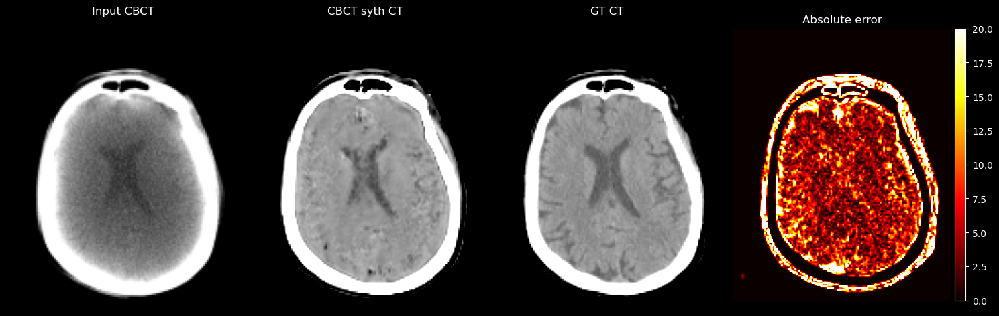

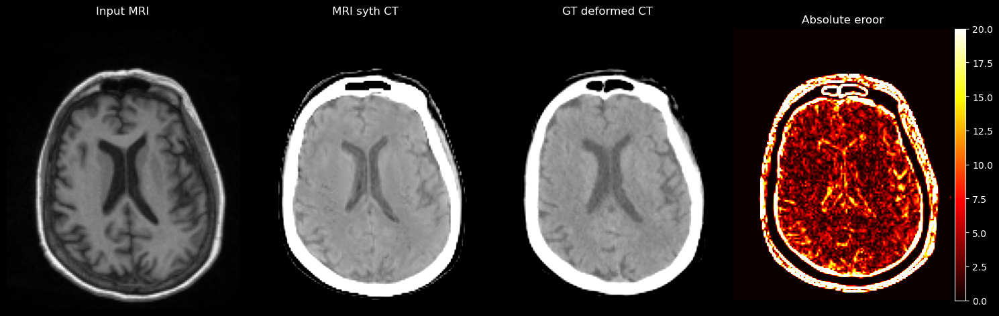

 40%|████      | 4/10 [01:04<01:36, 16.00s/it]

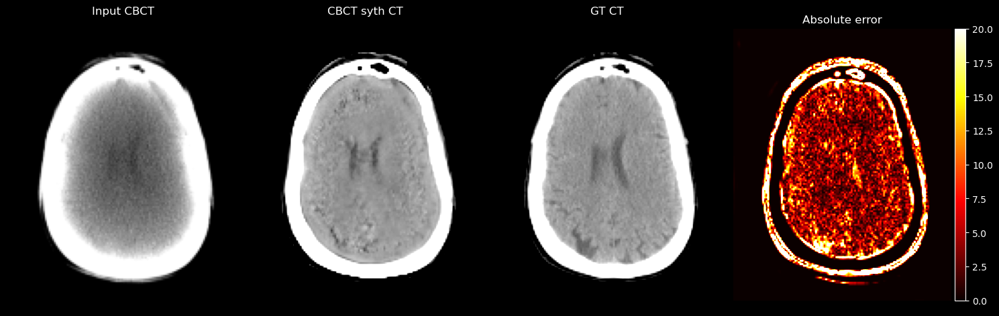

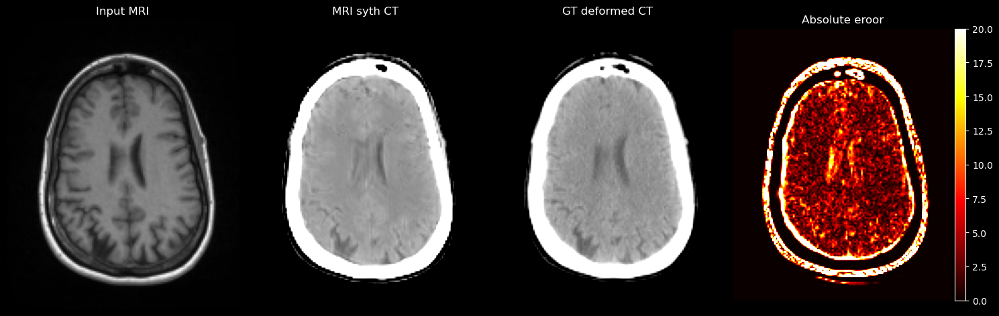

 50%|█████     | 5/10 [01:20<01:19, 15.94s/it]

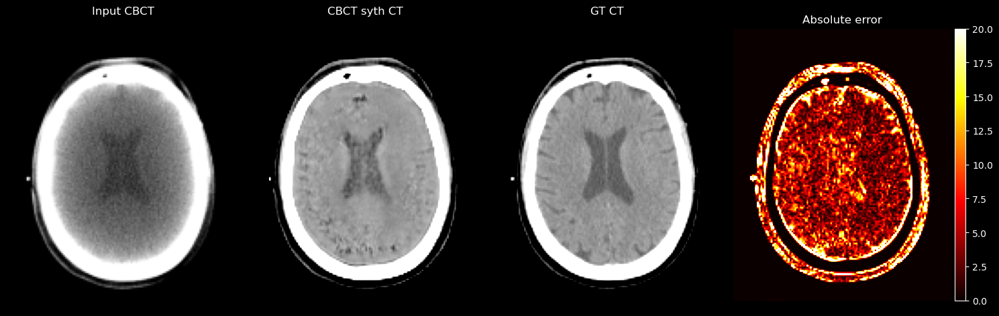

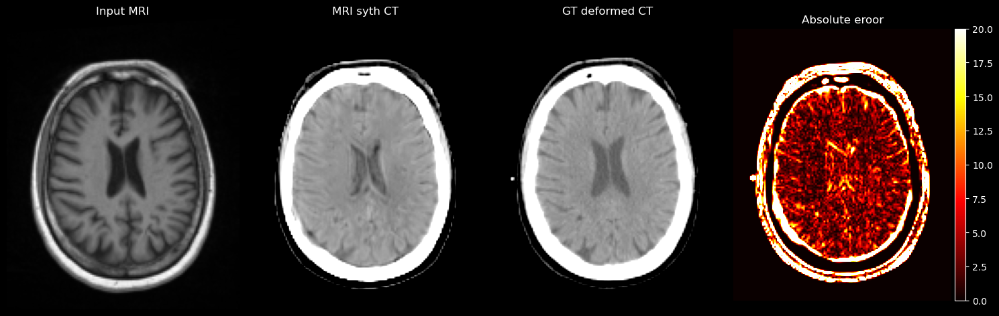

 60%|██████    | 6/10 [01:35<01:02, 15.67s/it]

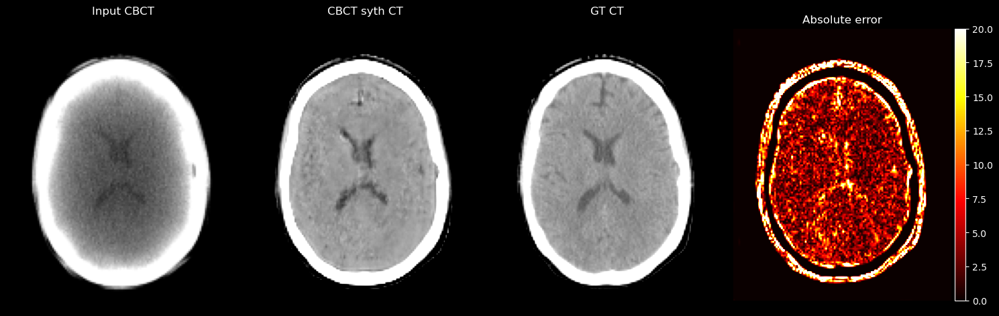

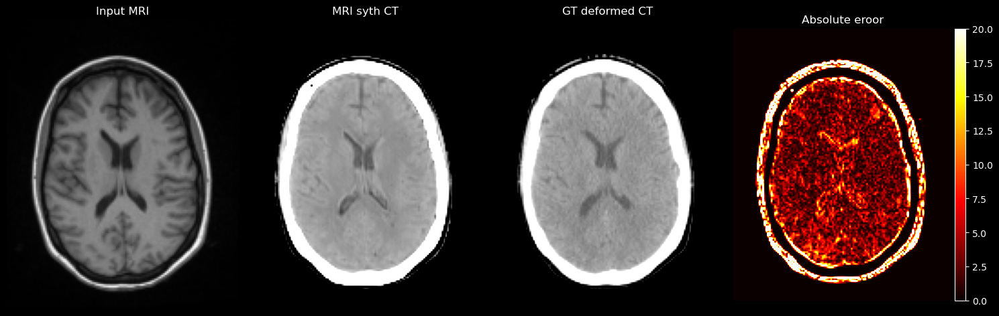

 70%|███████   | 7/10 [01:50<00:46, 15.65s/it]

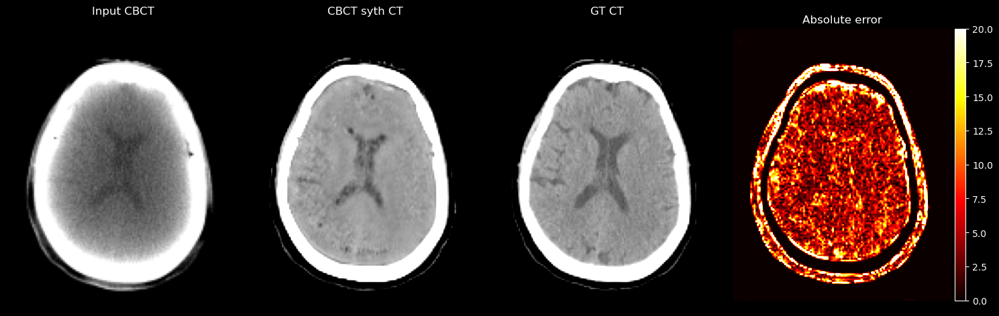

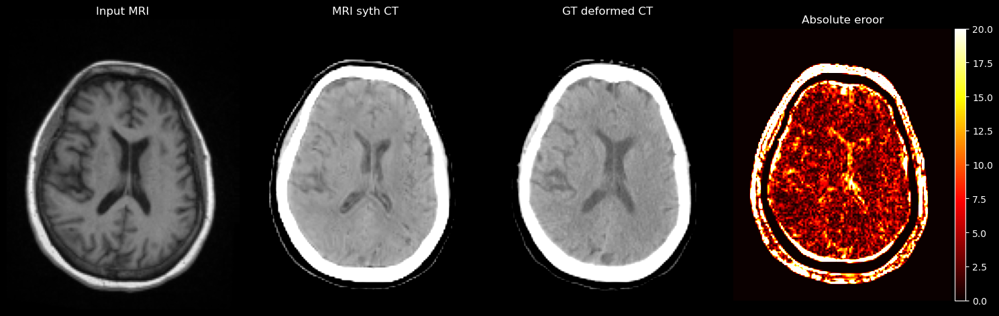

 80%|████████  | 8/10 [02:06<00:31, 15.57s/it]

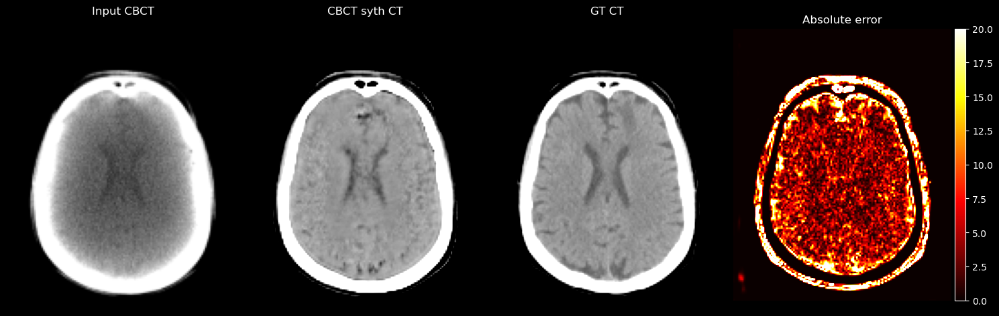

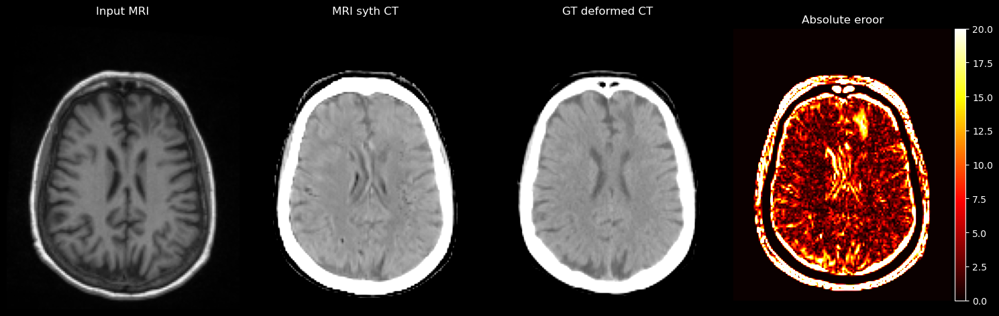

 90%|█████████ | 9/10 [02:22<00:15, 15.67s/it]

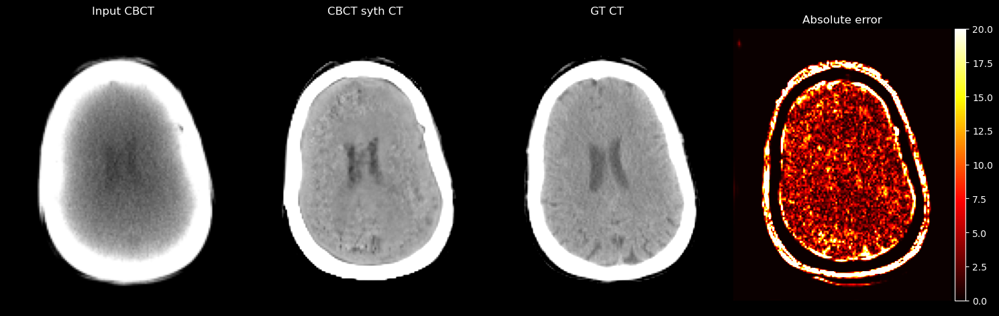

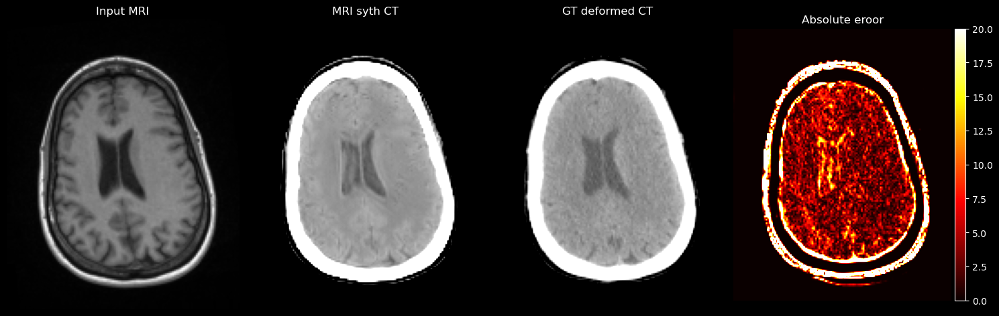

100%|██████████| 10/10 [02:37<00:00, 15.75s/it]

4.575190128658062 0.32672905915179584 5.02972312271595 0.6524440577699735
0.864214115420275 0.006723949184511309 0.8357593236384432 0.021667749670400607


In [4]:
G = networks_gan.JSRCascade(separate_decoders=True, res=True, version='v3').to(device)
checkpoint = torch.load('JSRCascade_l1100_multi0.3_reg100_seg0_ep109.pt',map_location='cpu')
G.load_state_dict(checkpoint['G_state_dict'])
l1_cbct = []
l1_mr = []
ssim_cbct = []
ssim_mr = []

for i in tqdm(range(10)):
    data = torch.load(f'/mnt/blackhole-data2/RadOnc_Brain/Validation/valid_{i}.pt')
    cbct_fixed = data['cbct_fixed'].to(device)
    mr_moving = data['mr_moving'].to(device)
    ct_fixed = torch.from_numpy(data['ct_fixed']).unsqueeze(0).unsqueeze(0).to(device)
    ct_moving = torch.from_numpy(data['ct_moving']).unsqueeze(0).unsqueeze(0).to(device)
    
    with torch.no_grad():
#         _, ct_moving_synth, ct_fixed_synth = G(mr_moving, cbct_fixed)
        _, ct_moving_synths, ct_fixed_synths = G(mr_moving, cbct_fixed)
        ct_moving_synth = ct_moving_synths[0]
        ct_fixed_synth = ct_fixed_synths[0]
        
        l1_cbct.append(losses.MaskedL1(high_thresh=0.8).loss(ct_fixed_synth, ct_fixed).item()*200)
        l1_mr.append(losses.MaskedL1(high_thresh=0.8).loss(ct_moving_synth, ct_moving).item()*200)
        mask = ct_fixed.cpu().squeeze().numpy() < 0.8
        masked_ct = np.multiply(ct_fixed.cpu().squeeze().numpy(),mask)
        masked_ct_synth = np.multiply(ct_fixed_synth.cpu().squeeze().numpy(),mask)
        ssim_cbct.append(ssim(masked_ct_synth, masked_ct, gaussian_weights=True, data_range=1.0))
        mask = ct_moving.cpu().squeeze().numpy() < 0.8
        masked_ct = np.multiply(ct_moving.cpu().squeeze().numpy(),mask)
        masked_ct_synth = np.multiply(ct_moving_synth.cpu().squeeze().numpy(),mask)
        ssim_mr.append(ssim(masked_ct_synth, masked_ct, gaussian_weights=True, data_range=1.0))

    islice = 72
    fig, ax = plt.subplots(1,4,figsize=(15,9))
    np.vectorize(lambda ax: ax.axis('off'))(ax)
    ax[0].imshow(cbct_fixed.cpu().numpy()[0,0,:,:,islice].T, cmap='gray')
    ax[0].set_title('Input CBCT')
    ax[1].imshow(ct_fixed_synth.cpu().numpy()[0,0,:,:,islice].T, cmap='gray', vmin=0.3, vmax=0.9)
    ax[1].set_title('CBCT syth CT')
    ax[2].imshow(ct_fixed.squeeze().cpu().numpy()[:,:,islice].T, cmap='gray', vmin=0.3, vmax=0.9)
    ax[2].set_title('GT CT')
    error = ct_fixed.squeeze().cpu().numpy()[:,:,islice].T - ct_fixed_synth.cpu().numpy()[0,0,:,:,islice].T
    im = ax[3].imshow(np.abs(error * 200), cmap='hot', vmin=0, vmax=20)
    ax[3].set_title('Absolute error')
    divider = make_axes_locatable(ax[3])
    cax = divider.append_axes('right', size='5%', pad=0.05)
    fig.colorbar(im, cax=cax, orientation='vertical')
    plt.tight_layout()
    plt.show()
    fig, ax = plt.subplots(1,4,figsize=(15,9))
    np.vectorize(lambda ax: ax.axis('off'))(ax)
    ax[0].imshow(mr_moving.cpu().numpy()[0,0,:,:,islice].T, cmap='gray')
    ax[0].set_title('Input MRI')
    ax[1].imshow(ct_moving_synth.cpu().numpy()[0,0,:,:,islice].T, cmap='gray', vmin=0.3, vmax=0.9)
    ax[1].set_title('MRI syth CT')
    ax[2].imshow(ct_moving.squeeze().cpu().numpy()[:,:,islice].T, cmap='gray', vmin=0.3, vmax=0.9)
    ax[2].set_title('GT deformed CT')
    error = ct_moving.squeeze().cpu().numpy()[:,:,islice].T - ct_moving_synth.cpu().numpy()[0,0,:,:,islice].T
    im = ax[3].imshow(np.abs(error * 200), cmap='hot', vmin=0, vmax=20)
    ax[3].set_title('Absolute eroor')
    divider = make_axes_locatable(ax[3])
    cax = divider.append_axes('right', size='5%', pad=0.05)
    fig.colorbar(im, cax=cax, orientation='vertical')
    plt.tight_layout()
    plt.show()

print(np.mean(l1_cbct), np.std(l1_cbct), np.mean(l1_mr), np.std(l1_mr))
print(np.mean(ssim_cbct), np.std(ssim_cbct), np.mean(ssim_mr), np.std(ssim_mr))

  0%|          | 0/10 [00:00<?, ?it/s]

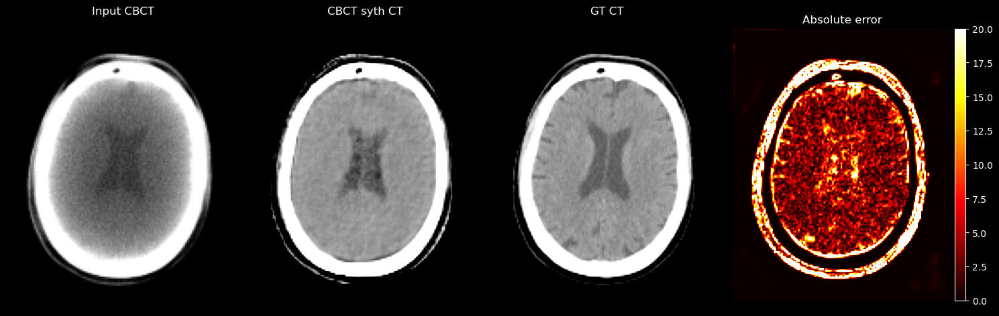

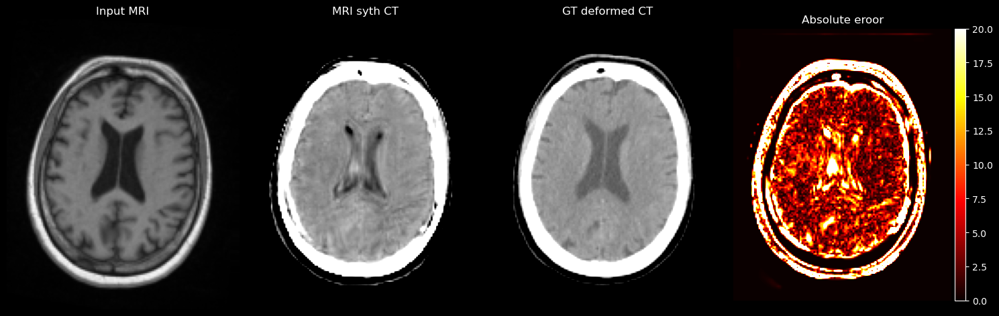

 10%|█         | 1/10 [00:15<02:15, 15.01s/it]

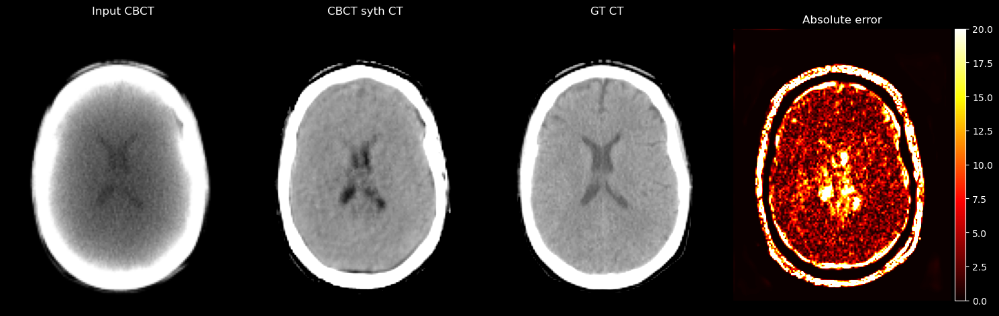

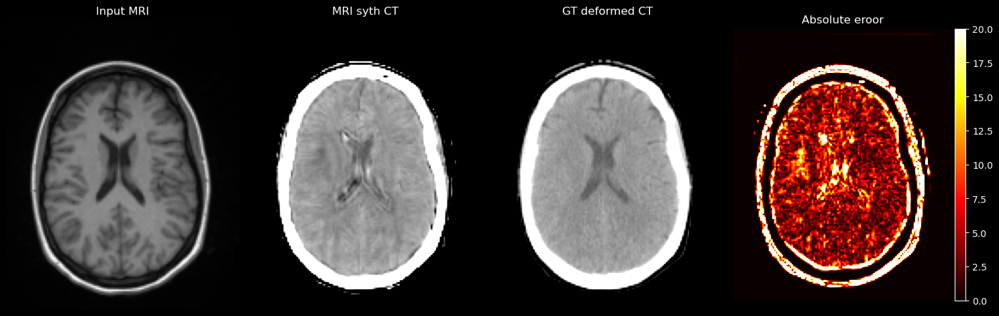

 20%|██        | 2/10 [00:30<02:02, 15.28s/it]

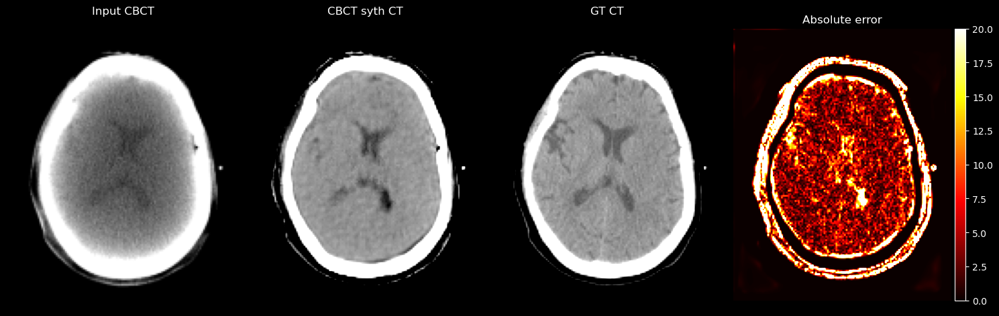

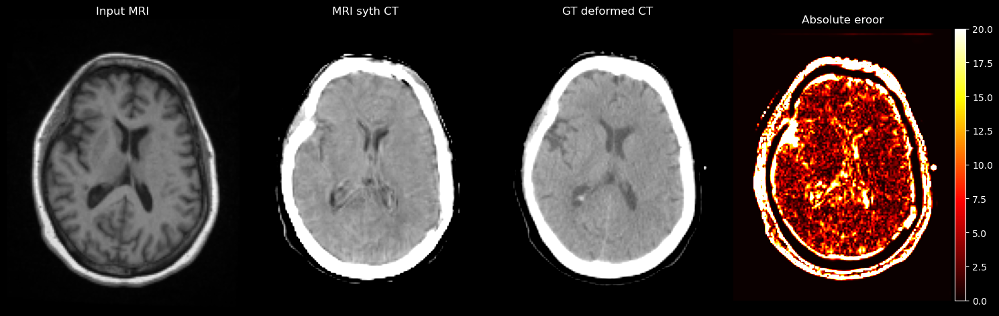

 30%|███       | 3/10 [00:45<01:46, 15.20s/it]

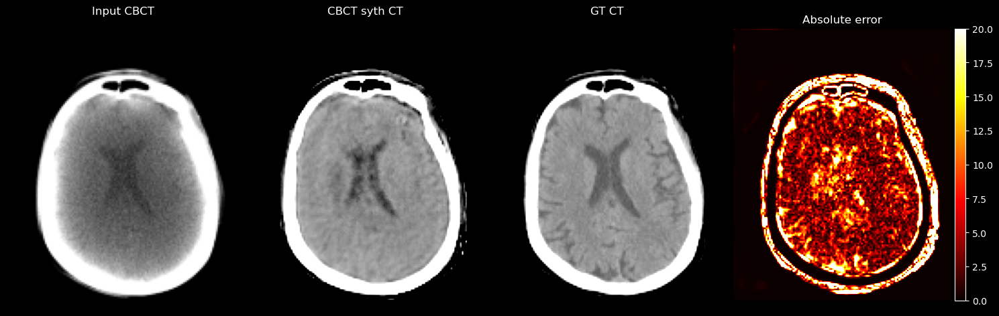

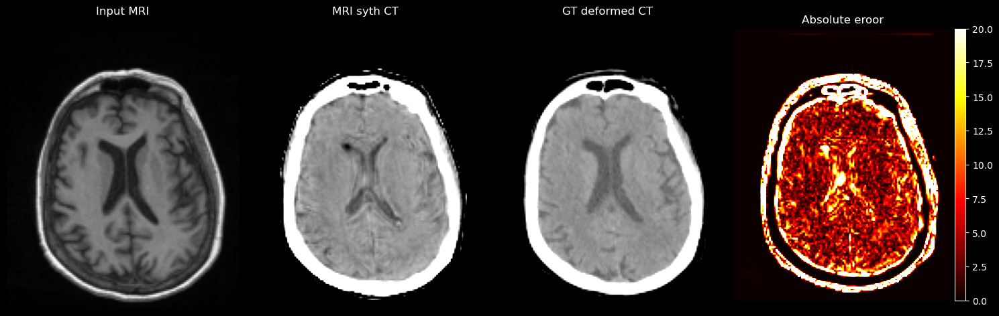

 40%|████      | 4/10 [01:01<01:32, 15.36s/it]

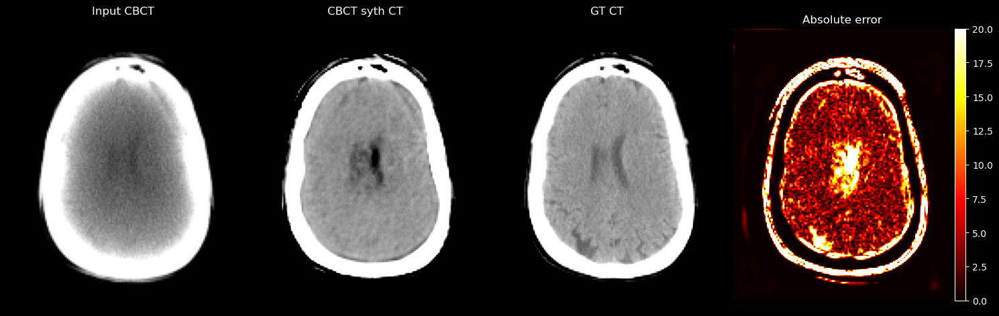

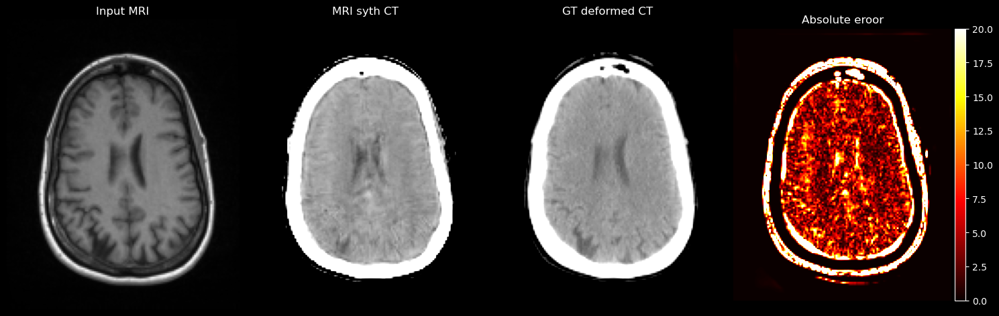

 50%|█████     | 5/10 [01:16<01:16, 15.28s/it]

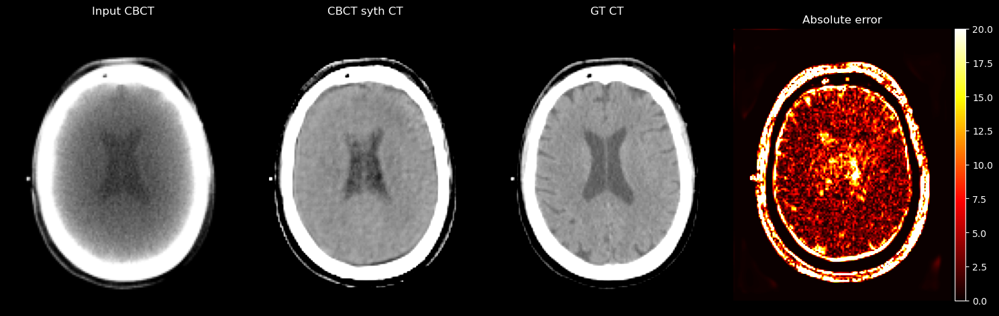

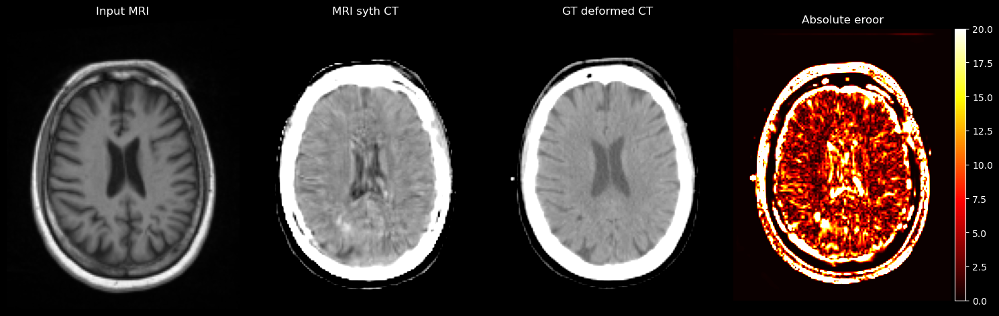

 60%|██████    | 6/10 [01:31<01:00, 15.24s/it]

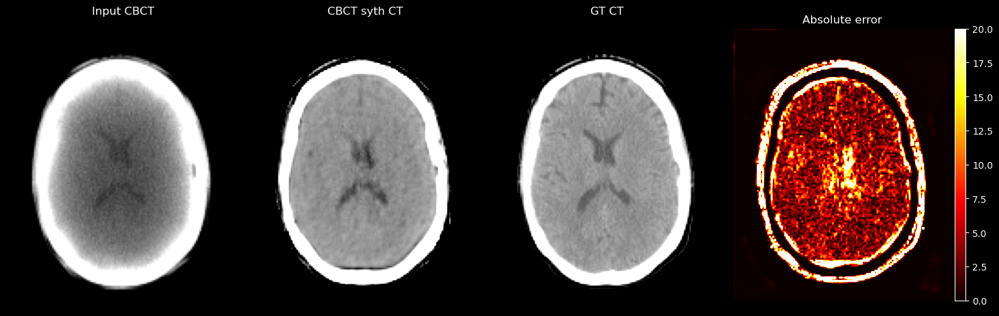

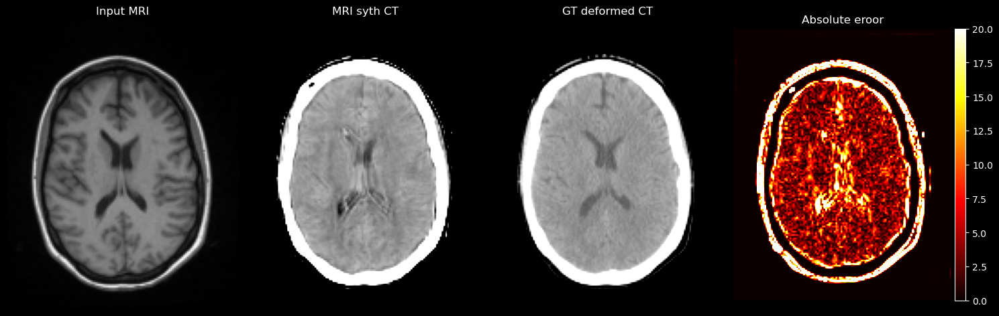

 70%|███████   | 7/10 [01:46<00:45, 15.21s/it]

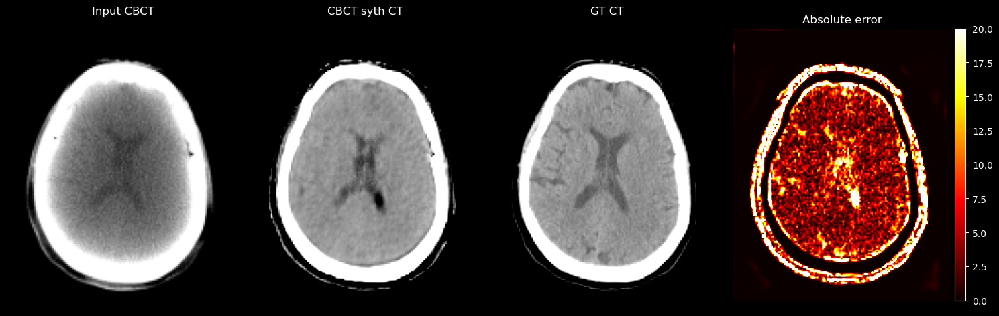

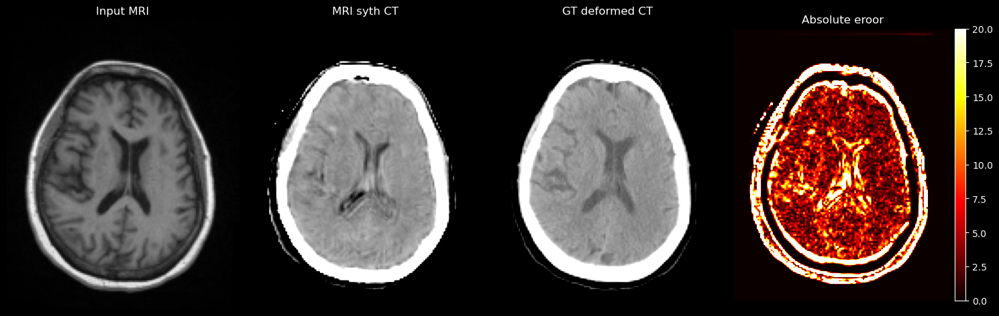

 80%|████████  | 8/10 [02:02<00:30, 15.36s/it]

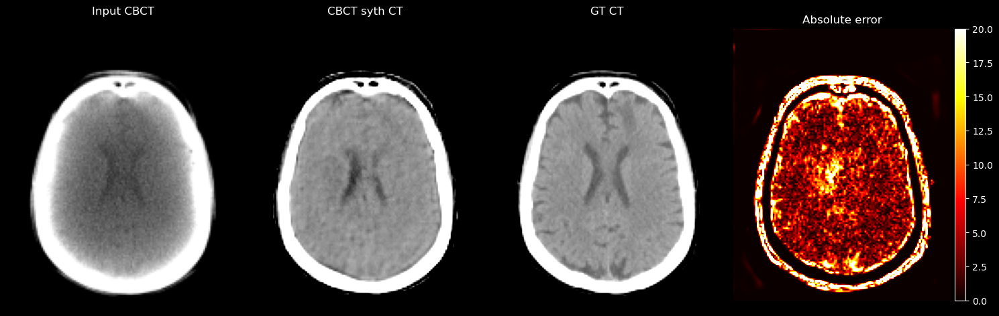

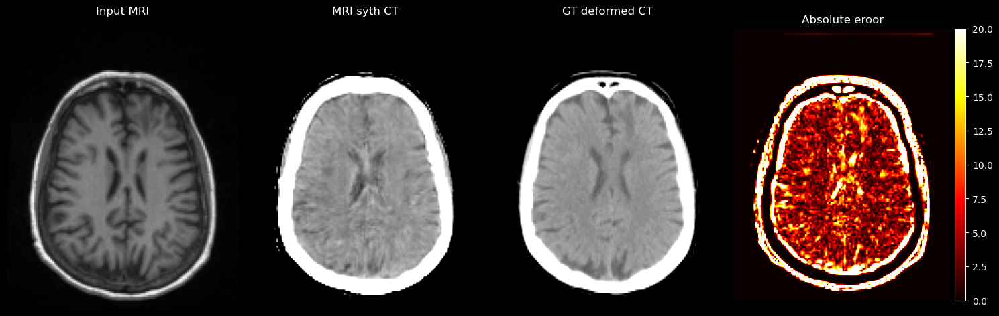

 90%|█████████ | 9/10 [02:17<00:15, 15.45s/it]

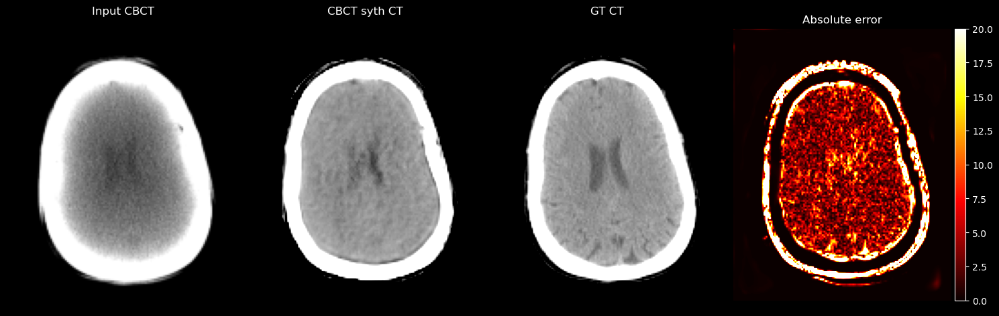

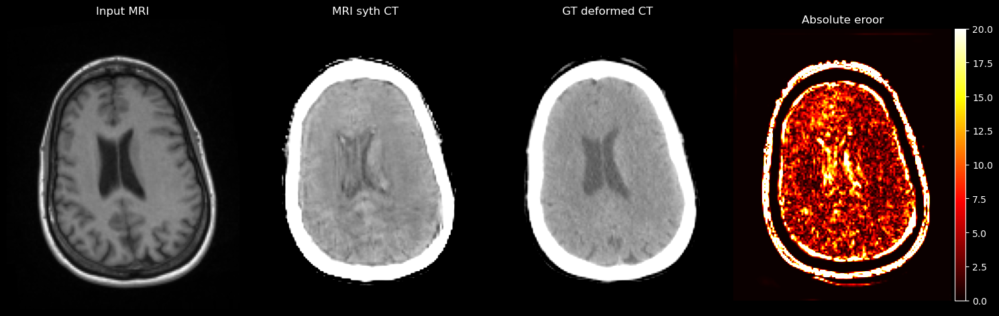

100%|██████████| 10/10 [02:33<00:00, 15.34s/it]

5.059569693109564 0.2851345139954089 5.449443496763706 0.40973367087283524
0.8302640939840694 0.007755588396926865 0.7862653122156141 0.017152908912449052


In [5]:
G = networks_gan.JSRCascade(separate_decoders=True, res=True, version='v3').to(device)
checkpoint = torch.load('JSRCascadeonnewdata_l1100_multi0.3_reg100_seg6_ep99.pt',map_location='cpu')
G.load_state_dict(checkpoint['G_state_dict'])
l1_cbct = []
l1_mr = []
ssim_cbct = []
ssim_mr = []

for i in tqdm(range(10)):
    data = torch.load(f'/mnt/blackhole-data2/RadOnc_Brain/Validation/valid_{i}.pt')
    cbct_fixed = data['cbct_fixed'].to(device)
    mr_moving = data['mr_moving'].to(device)
    ct_fixed = torch.from_numpy(data['ct_fixed']).unsqueeze(0).unsqueeze(0).to(device)
    ct_moving = torch.from_numpy(data['ct_moving']).unsqueeze(0).unsqueeze(0).to(device)
    
    with torch.no_grad():
#         _, ct_moving_synth, ct_fixed_synth = G(mr_moving, cbct_fixed)
        _, ct_moving_synths, ct_fixed_synths = G(mr_moving, cbct_fixed)
        ct_moving_synth = ct_moving_synths[0]
        ct_fixed_synth = ct_fixed_synths[0]
        
        l1_cbct.append(losses.MaskedL1(high_thresh=0.8).loss(ct_fixed_synth, ct_fixed).item()*200)
        l1_mr.append(losses.MaskedL1(high_thresh=0.8).loss(ct_moving_synth, ct_moving).item()*200)
        mask = ct_fixed.cpu().squeeze().numpy() < 0.8
        masked_ct = np.multiply(ct_fixed.cpu().squeeze().numpy(),mask)
        masked_ct_synth = np.multiply(ct_fixed_synth.cpu().squeeze().numpy(),mask)
        ssim_cbct.append(ssim(masked_ct_synth, masked_ct, gaussian_weights=True, data_range=1.0))
        mask = ct_moving.cpu().squeeze().numpy() < 0.8
        masked_ct = np.multiply(ct_moving.cpu().squeeze().numpy(),mask)
        masked_ct_synth = np.multiply(ct_moving_synth.cpu().squeeze().numpy(),mask)
        ssim_mr.append(ssim(masked_ct_synth, masked_ct, gaussian_weights=True, data_range=1.0))

    islice = 72
    fig, ax = plt.subplots(1,4,figsize=(15,9))
    np.vectorize(lambda ax: ax.axis('off'))(ax)
    ax[0].imshow(cbct_fixed.cpu().numpy()[0,0,:,:,islice].T, cmap='gray')
    ax[0].set_title('Input CBCT')
    ax[1].imshow(ct_fixed_synth.cpu().numpy()[0,0,:,:,islice].T, cmap='gray', vmin=0.3, vmax=0.9)
    ax[1].set_title('CBCT syth CT')
    ax[2].imshow(ct_fixed.squeeze().cpu().numpy()[:,:,islice].T, cmap='gray', vmin=0.3, vmax=0.9)
    ax[2].set_title('GT CT')
    error = ct_fixed.squeeze().cpu().numpy()[:,:,islice].T - ct_fixed_synth.cpu().numpy()[0,0,:,:,islice].T
    im = ax[3].imshow(np.abs(error * 200), cmap='hot', vmin=0, vmax=20)
    ax[3].set_title('Absolute error')
    divider = make_axes_locatable(ax[3])
    cax = divider.append_axes('right', size='5%', pad=0.05)
    fig.colorbar(im, cax=cax, orientation='vertical')
    plt.tight_layout()
    plt.show()
    fig, ax = plt.subplots(1,4,figsize=(15,9))
    np.vectorize(lambda ax: ax.axis('off'))(ax)
    ax[0].imshow(mr_moving.cpu().numpy()[0,0,:,:,islice].T, cmap='gray')
    ax[0].set_title('Input MRI')
    ax[1].imshow(ct_moving_synth.cpu().numpy()[0,0,:,:,islice].T, cmap='gray', vmin=0.3, vmax=0.9)
    ax[1].set_title('MRI syth CT')
    ax[2].imshow(ct_moving.squeeze().cpu().numpy()[:,:,islice].T, cmap='gray', vmin=0.3, vmax=0.9)
    ax[2].set_title('GT deformed CT')
    error = ct_moving.squeeze().cpu().numpy()[:,:,islice].T - ct_moving_synth.cpu().numpy()[0,0,:,:,islice].T
    im = ax[3].imshow(np.abs(error * 200), cmap='hot', vmin=0, vmax=20)
    ax[3].set_title('Absolute eroor')
    divider = make_axes_locatable(ax[3])
    cax = divider.append_axes('right', size='5%', pad=0.05)
    fig.colorbar(im, cax=cax, orientation='vertical')
    plt.tight_layout()
    plt.show()

print(np.mean(l1_cbct), np.std(l1_cbct), np.mean(l1_mr), np.std(l1_mr))
print(np.mean(ssim_cbct), np.std(ssim_cbct), np.mean(ssim_mr), np.std(ssim_mr))

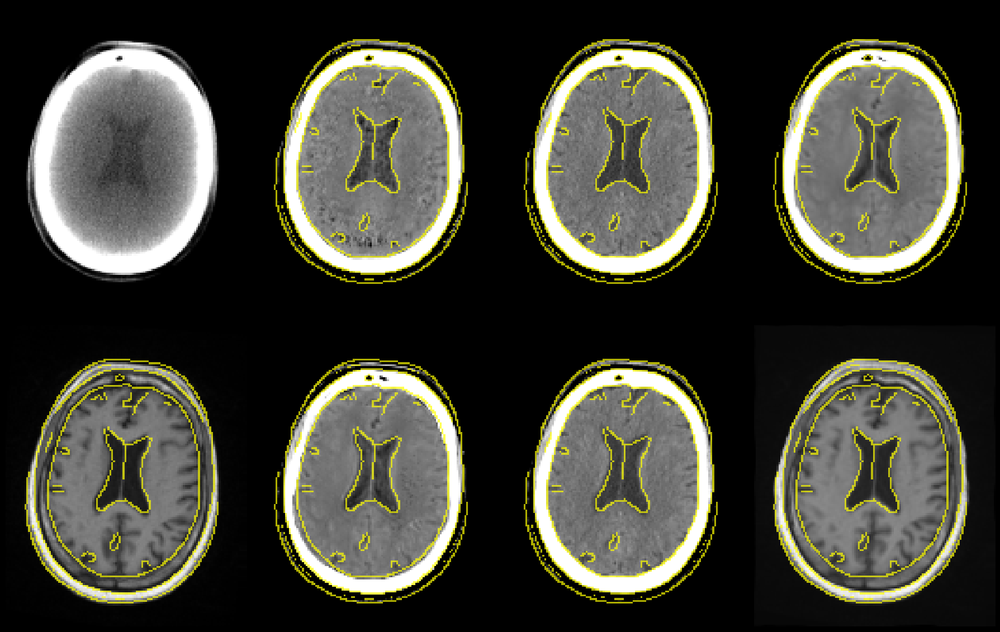

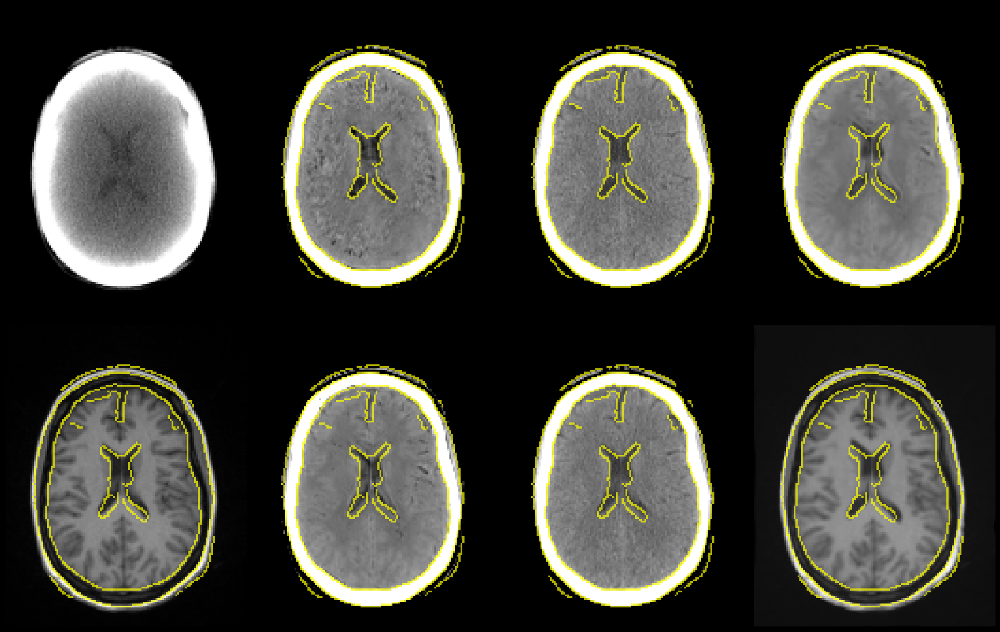

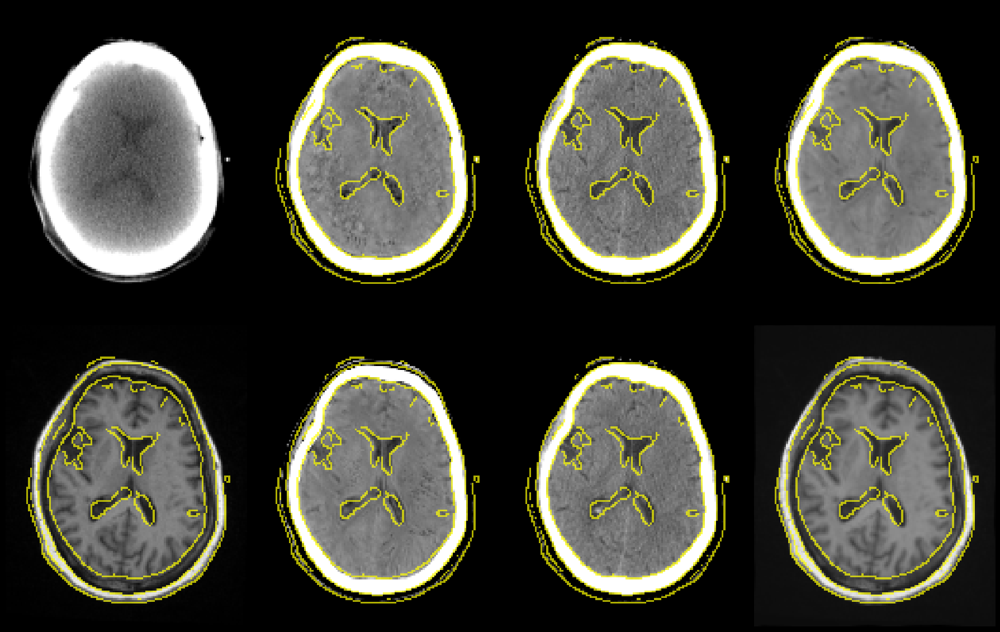

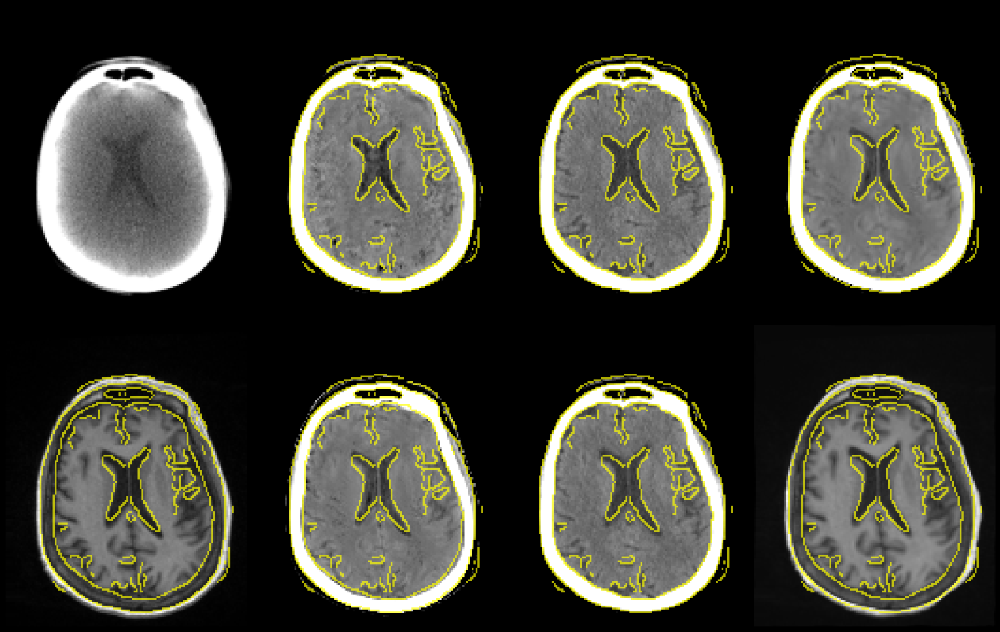

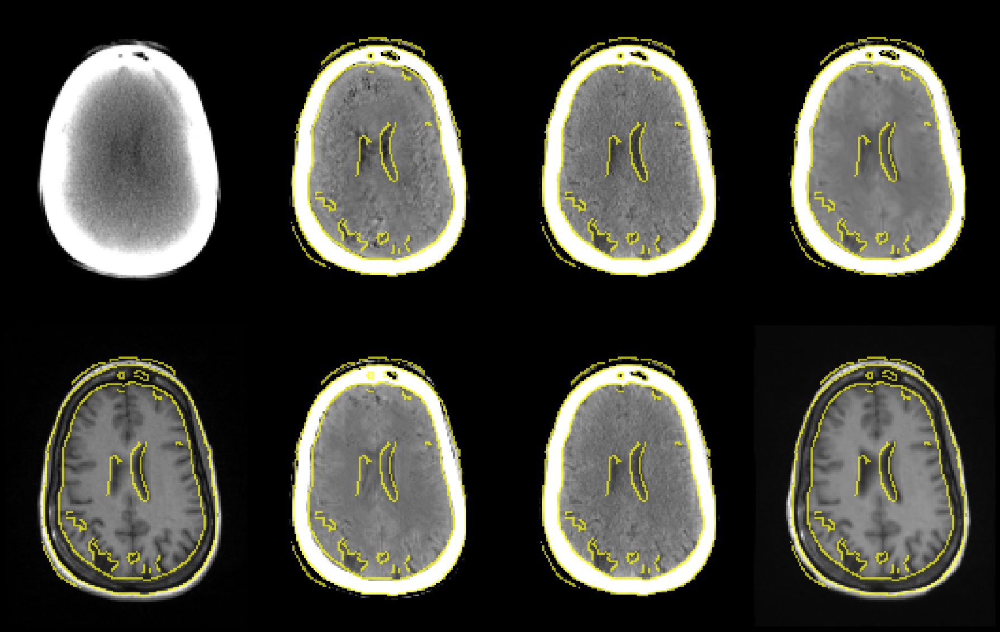

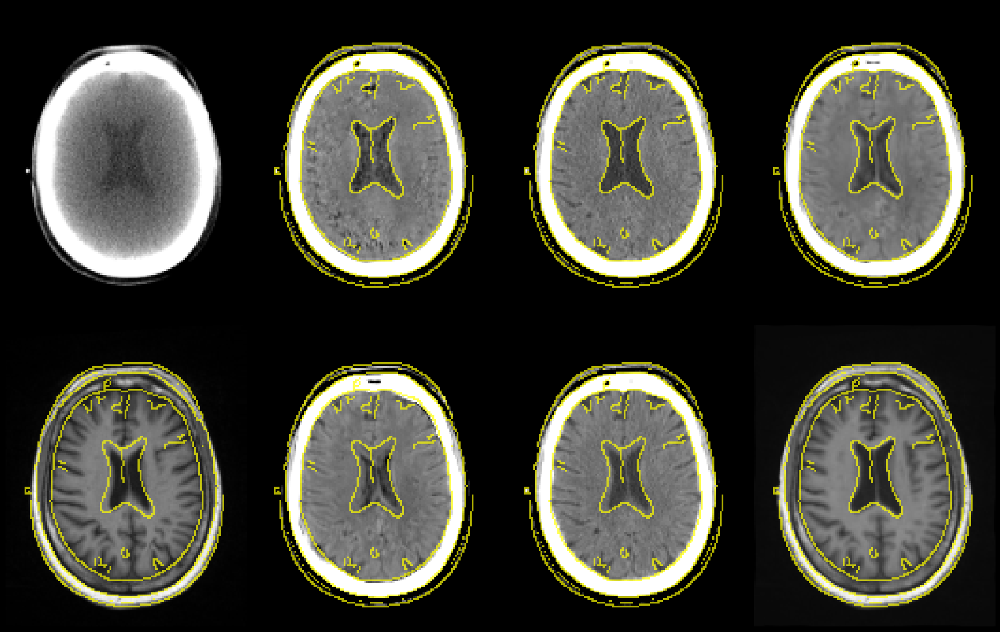

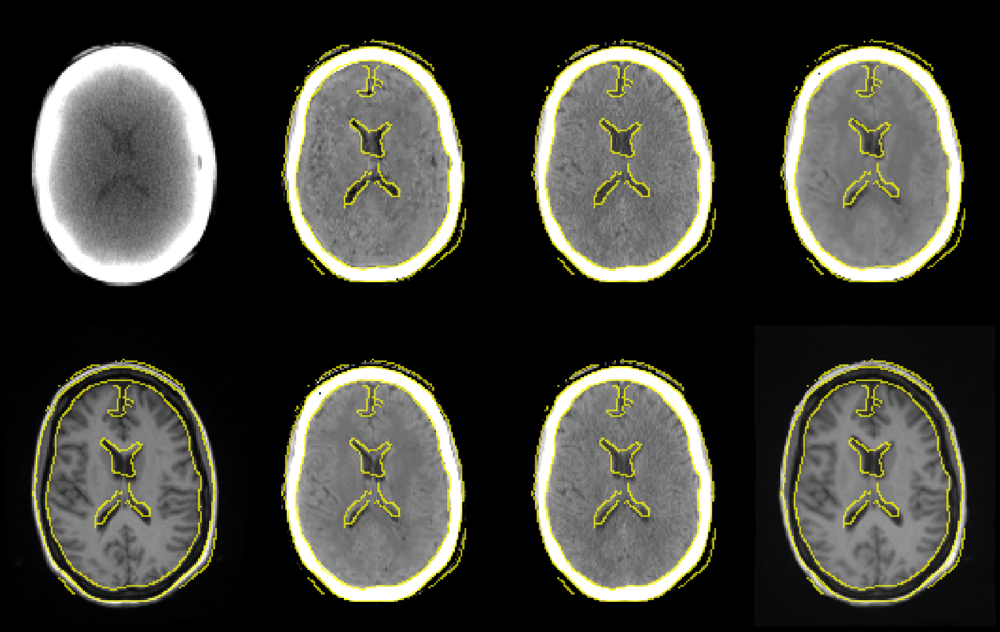

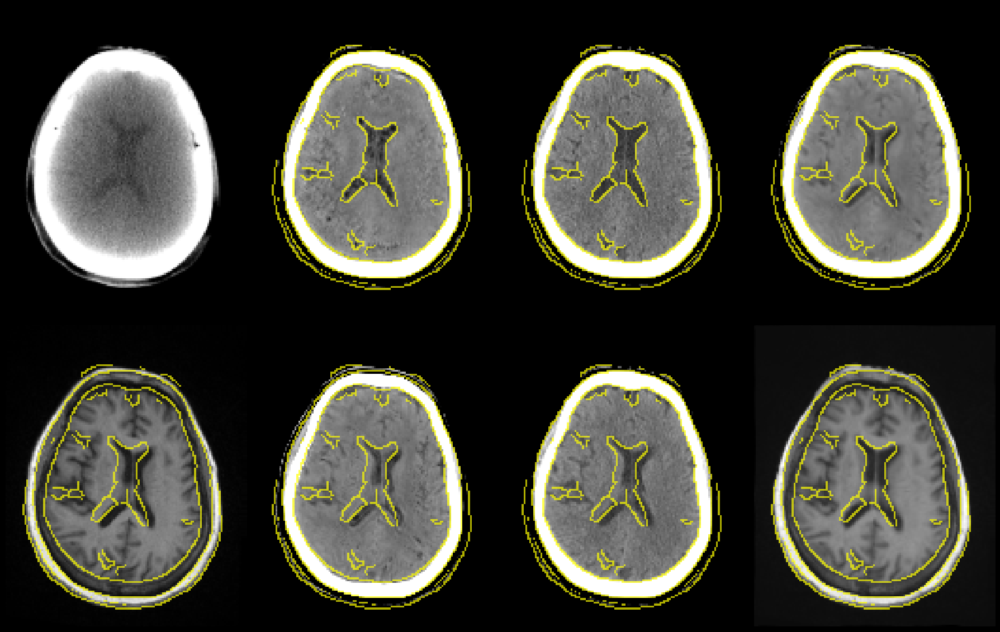

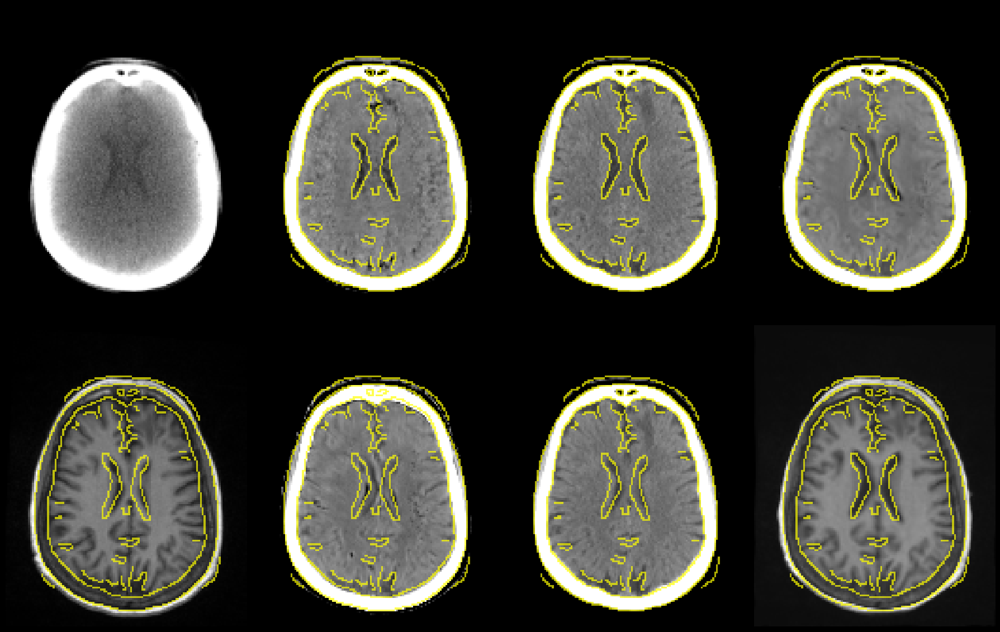

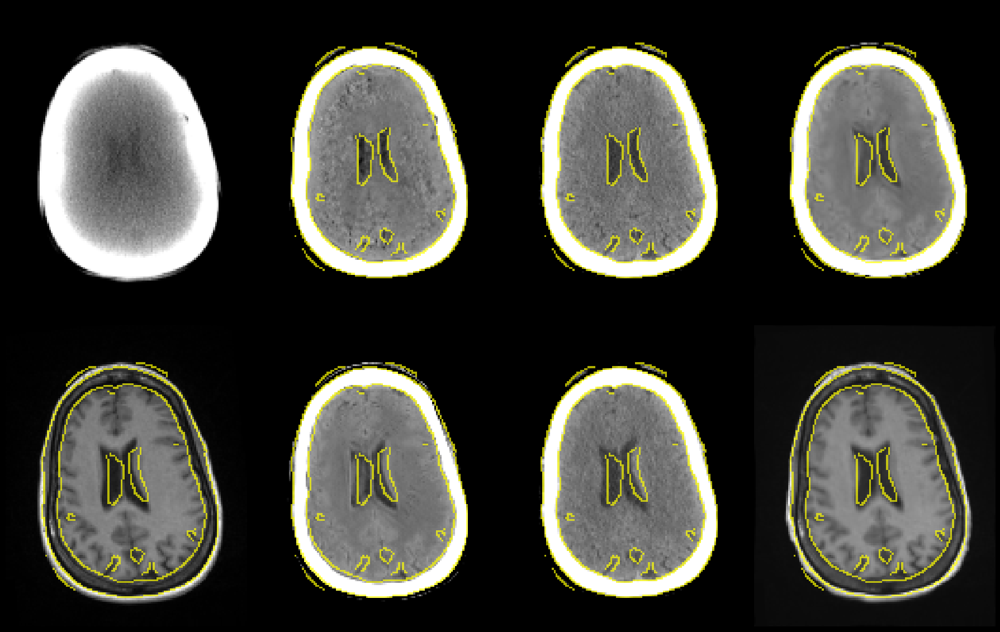

In [8]:
metrics = pd.DataFrame()
mask_val = [1,2,23,5,19,29,8]
G = networks_gan.JSRCascade(separate_decoders=True, res=True, version='v3').to(device)
valid_dataset = RadOncValidationDataset("/mnt/blackhole-data2/RadOnc_Brain/Validation", num_samples=None, supervision=True,
                                            return_segmentation=True)
for ep in range(1):
    checkpoint = torch.load('JSRCascade_l1100_multi0.3_reg100_seg0_ep109.pt',map_location='cpu')
    G.load_state_dict(checkpoint['G_state_dict'])
    dice_before_total = []
    dice_after_total = []
    hd_before_total = []
    sd_before_total = []
    hd_after_total = []
    sd_after_total = []
    tre_before_total = []
    tre_after_total = []
    
    for i, batch in enumerate(valid_dataset):
        cbct_fixed, mr_moving, ct_fixed, ct_moving, seg_fixed, seg_moving = batch
        cbct_fixed = cbct_fixed.float().to(device)
        mr_moving = mr_moving.float().to(device)
        ct_fixed = ct_fixed.float().to(device)
        ct_moving = ct_moving.float().to(device)
        seg_fixed = seg_fixed.float().to(device)
        seg_moving = seg_moving.float().to(device)

        with torch.no_grad():
            flow, ct_moving_synth, ct_fixed_synth = G(mr_moving, cbct_fixed)

            # the flow[0] means the final highest resolution from the cascade network.
            mr_reg = vxm.layers.SpatialTransformer([128,160,128], mode='bilinear').to(device)(mr_moving, flow[0])
            ct_reg_synth = vxm.layers.SpatialTransformer([128,160,128], mode='bilinear').to(device)(ct_moving_synth[0], flow[0])
            seg_reg = vxm.layers.SpatialTransformer([128,160,128], mode='nearest').to(device)(seg_moving, flow[0])

            dice_before = []
            hd_before = []
            sd_before = []
            dice_after= []
            hd_after = []
            sd_after = []
            for j, val in enumerate(mask_val):
                mask_fixed = seg_fixed[:,j:j+1,:,:,:]
                mask_moving = seg_moving[:,j:j+1,:,:,:]
                mask_registered = seg_reg[:,j:j+1,:,:,:]
                dice_before.append(-losses.Dice().loss(mask_fixed,mask_moving).item())
                dice_after.append(-losses.Dice().loss(mask_fixed,mask_registered).item())
                metrics_before = compute_surface_metrics(np.squeeze(mask_fixed.squeeze().cpu().numpy())==1, np.squeeze(mask_moving.squeeze().cpu().numpy())==1)
                metrics_after = compute_surface_metrics(np.squeeze(mask_fixed.squeeze().cpu().numpy())==1, np.squeeze(mask_registered.squeeze().cpu().numpy())==1)
                hd_before.append(metrics_before['hd'])
                hd_after.append(metrics_after['hd'])
                sd_before.append(metrics_before['avg_dist'])
                sd_after.append(metrics_after['avg_dist'])
                
            valid_ds = np.load(glob.glob(os.path.join("/mnt/blackhole-data2/RadOnc_Brain/Validation",'*.npz'))[i])
            seg_fixed = valid_ds['ventricle_fixed']
            seg_moving = valid_ds['ventricle_moving']
            seg_fixed = torch.from_numpy(resize(seg_fixed, [128,160,128], order=0, anti_aliasing=False)).unsqueeze(0).unsqueeze(0).to(device)
            seg_moving = torch.from_numpy(resize(seg_moving, [128,160,128], order=0, anti_aliasing=False)).unsqueeze(0).unsqueeze(0).to(device)
            seg_reg = vxm.layers.SpatialTransformer([128,160,128], mode='nearest').to(device)(seg_moving, flow[0])
            tre_before_total.append(compute_TRE(seg_fixed.squeeze().cpu().numpy(), seg_moving.squeeze().cpu().numpy(), [1,1,1]).mean())
            tre_after_total.append(compute_TRE(seg_fixed.squeeze().cpu().numpy(), seg_reg.squeeze().cpu().numpy(), [1,1,1]).mean())
            dice_before_total.append(dice_before)
            dice_after_total.append(dice_after)
            hd_before_total.append(hd_before)
            hd_after_total.append(hd_after)
            sd_before_total.append(sd_before)
            sd_after_total.append(sd_after)
            
            islice = 72
            fig, ax = plt.subplots(2,4,figsize=(18,12))
            np.vectorize(lambda ax: ax.axis('off'))(ax)
            ax[0,0].imshow(cbct_fixed.cpu().numpy()[0,0,:,:,islice].T, cmap='gray')
            ax[0,1].imshow(ct_fixed_synth[0].cpu().numpy()[0,0,:,:,islice].T, cmap='gray', vmin=0.4, vmax=0.95)
            ax[0,1].imshow(canny(ct_fixed.cpu().numpy()[:,:,islice].T, sigma=1), cmap=colormap_binary('yellow', alpha=0.7))
            ax[0,2].imshow(ct_fixed.cpu().numpy()[:,:,islice].T, cmap='gray', vmin=0.4, vmax=0.95)
            ax[0,2].imshow(canny(ct_fixed.cpu().numpy()[:,:,islice].T, sigma=1), cmap=colormap_binary('yellow', alpha=0.7))
            ax[0,3].imshow(ct_reg_synth.cpu().numpy()[0,0,:,:,islice].T, cmap='gray', vmin=0.4, vmax=0.95)
            ax[0,3].imshow(canny(ct_fixed.cpu().numpy()[:,:,islice].T, sigma=1), cmap=colormap_binary('yellow', alpha=0.7))

            ax[1,0].imshow(mr_moving.cpu().numpy()[0,0,:,:,islice].T, cmap='gray')
            ax[1,0].imshow(canny(ct_fixed.cpu().numpy()[:,:,islice].T, sigma=1), cmap=colormap_binary('yellow', alpha=0.7))
            ax[1,1].imshow(ct_moving_synth[0].cpu().numpy()[0,0,:,:,islice].T, cmap='gray', vmin=0.4, vmax=0.95)
            ax[1,1].imshow(canny(ct_fixed.cpu().numpy()[:,:,islice].T, sigma=1), cmap=colormap_binary('yellow', alpha=0.7))
            ax[1,2].imshow(ct_moving.cpu().numpy()[:,:,islice].T, cmap='gray', vmin=0.4, vmax=0.95)
            ax[1,2].imshow(canny(ct_fixed.cpu().numpy()[:,:,islice].T, sigma=1), cmap=colormap_binary('yellow', alpha=0.7))
            ax[1,3].imshow(mr_reg.cpu().numpy()[0,0,:,:,islice].T, cmap='gray')
            ax[1,3].imshow(canny(ct_fixed.cpu().numpy()[:,:,islice].T, sigma=1), cmap=colormap_binary('yellow', alpha=0.7))
            plt.tight_layout()
            plt.show()

           
    if ep == 0:
        d0 = {'Dice':np.reshape(np.array(dice_before_total),-1), 'HD':np.reshape(np.array(hd_before_total),-1), 'SD':np.reshape(np.array(sd_before_total),-1), 
              'anatomy':['3rd Ventricle', '4th Ventricle','Lateral Ventricles', 'Amygdala', 'Hippocampus', 'Thalamus', 'Caudate']*10, 'ep':[0]*70, 'method':['Rigid']*70}
        d0 = pd.DataFrame(data=d0)
        metrics = pd.concat([metrics, d0])

    d = {'Dice':np.reshape(np.array(dice_after_total),-1), 'HD':np.reshape(np.array(hd_after_total),-1), 'SD':np.reshape(np.array(sd_after_total),-1), 
         'anatomy':['3rd Ventricle', '4th Ventricle','Lateral Ventricles', 'Amygdala', 'Hippocampus', 'Thalamus', 'Caudate']*10, 'ep':[29+ep*10]*70, 'method':['JSR-Cascade']*70}
    d = pd.DataFrame(data=d)
    metrics = pd.concat([metrics, d])

In [10]:
for name in ['3rd Ventricle', '4th Ventricle','Lateral Ventricles', 'Amygdala', 'Hippocampus', 'Thalamus', 'Caudate']:
    data = metrics[metrics['anatomy']==name]
    data = data[data['method']=='JSR-Cascade']
    Dice = data['Dice'].mean()
    HD = data['HD'].mean()
    SD = data['SD'].mean()
    print(name, Dice, HD, SD)

3rd Ventricle 0.48798622041940687 3.0249586032220437 0.7167552718620172
4th Ventricle 0.46542403399944304 4.309594352132718 0.8683515917107197
Lateral Ventricles 0.7207829475402832 4.358012947282136 0.765037762545993
Amygdala 0.4812231421470642 3.922884729124424 0.8438615546595637
Hippocampus 0.5476525515317917 3.8306302402228796 0.7804734898869995
Thalamus 0.7545401275157928 3.9578423658679247 0.7607631911741819
Caudate 0.5588429272174835 4.208859542620518 0.7128631786112178


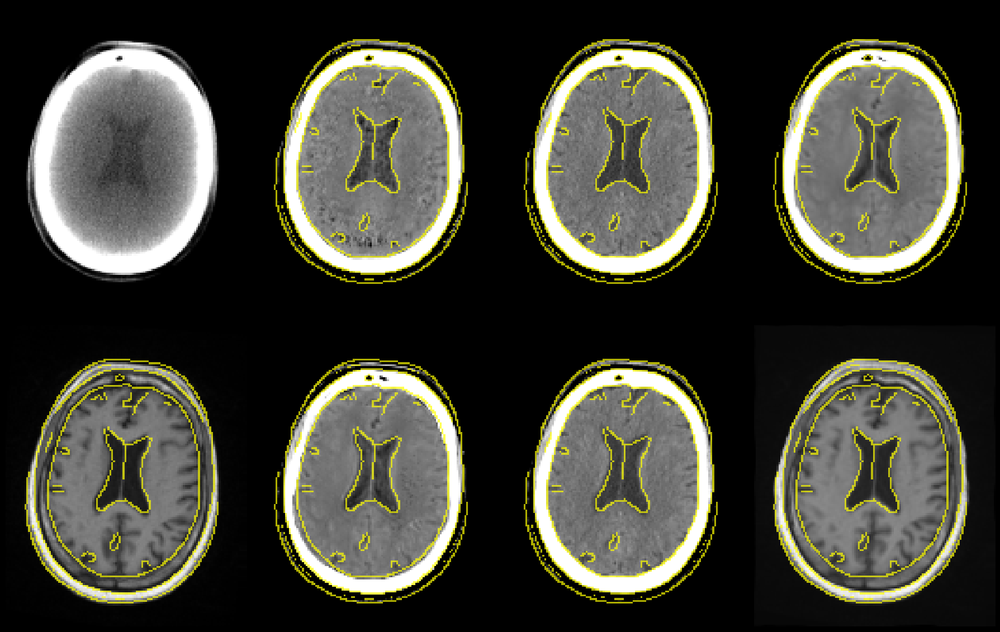

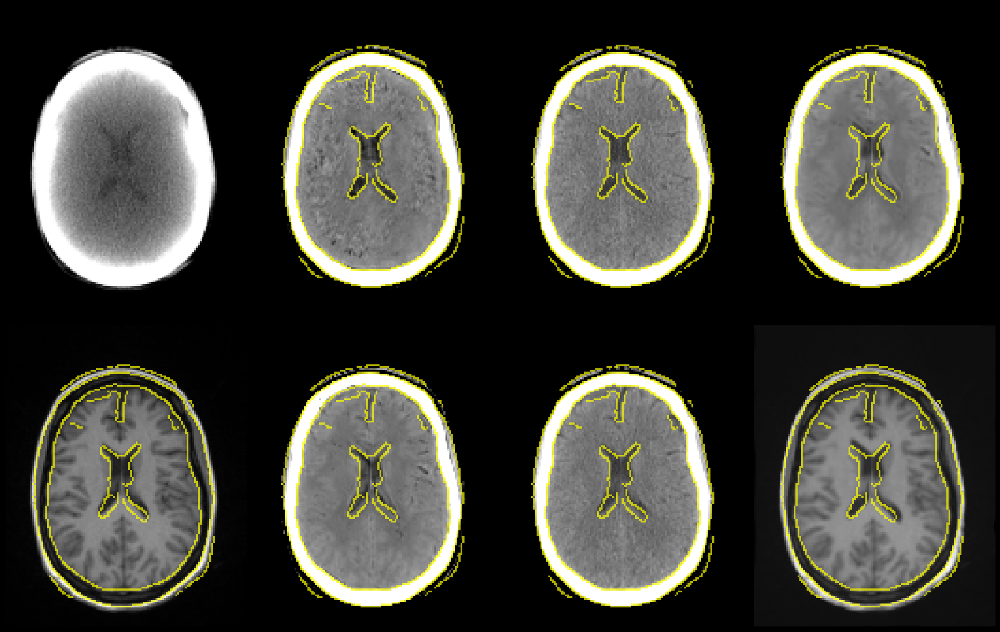

/home/myi16/anaconda3/envs/jsr_Y/lib/python3.9/site-packages/scipy/ndimage/measurements.py:1406: RuntimeWarning: invalid value encountered in double_scalars
  results = [sum(input * grids[dir].astype(float), labels, index) / normalizer


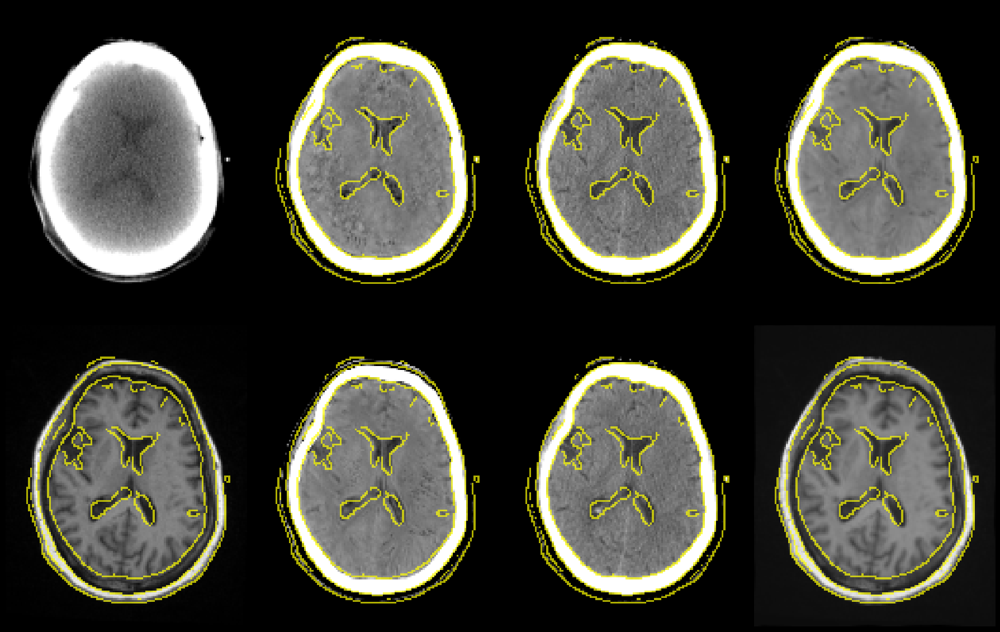

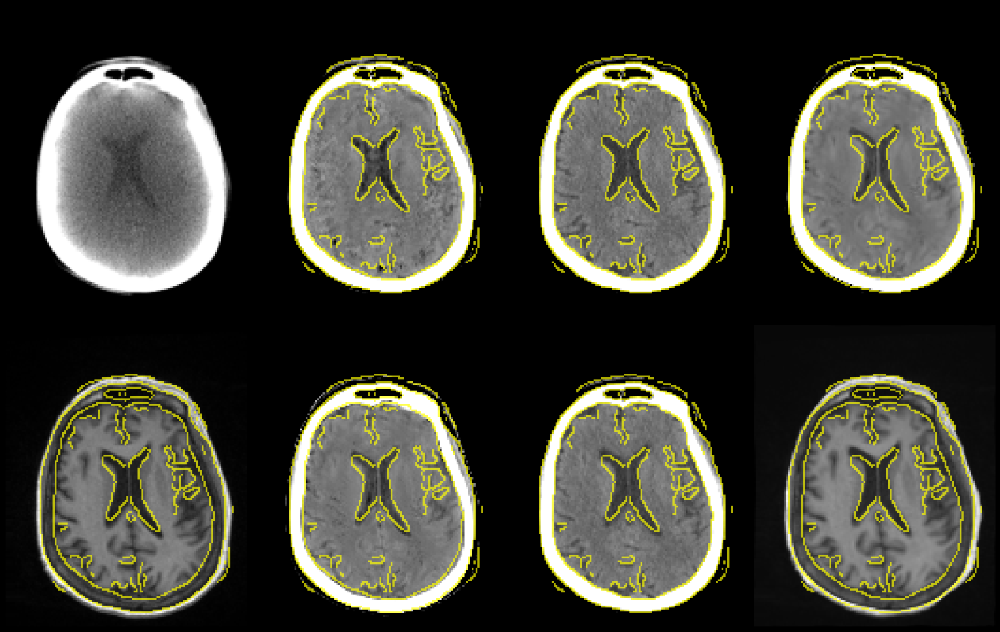

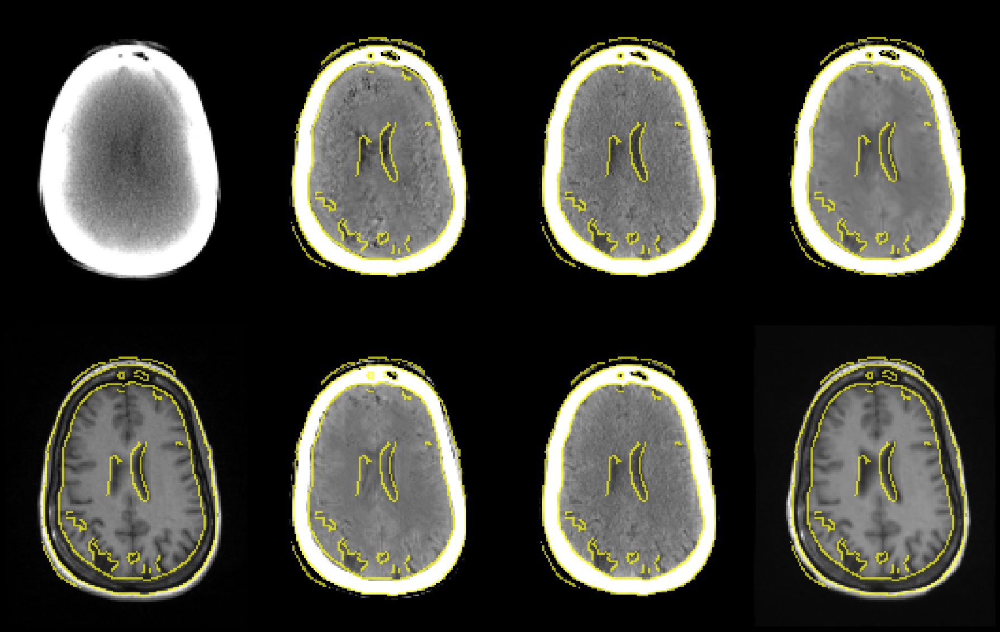

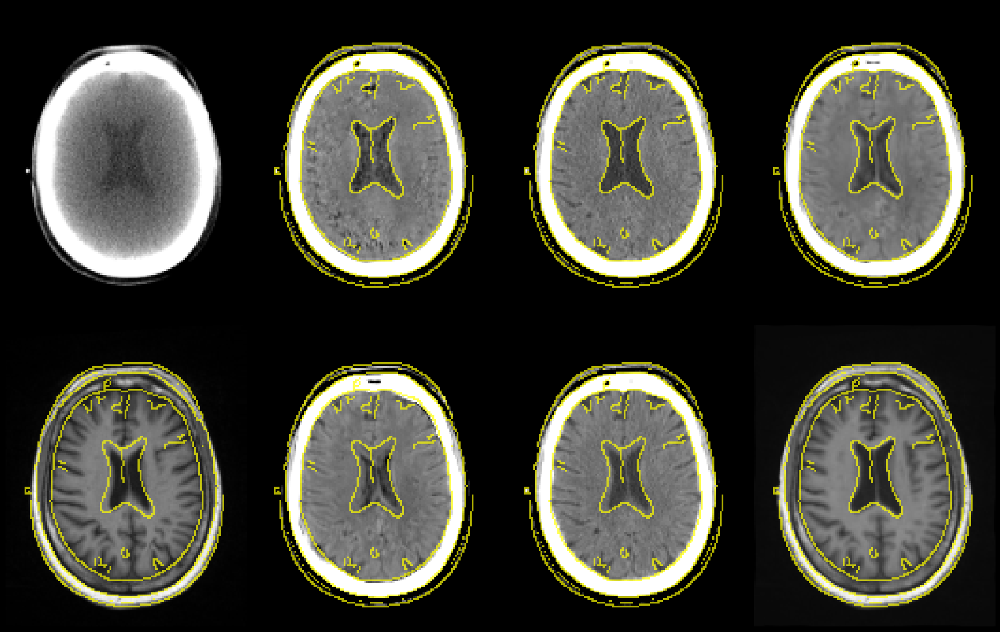

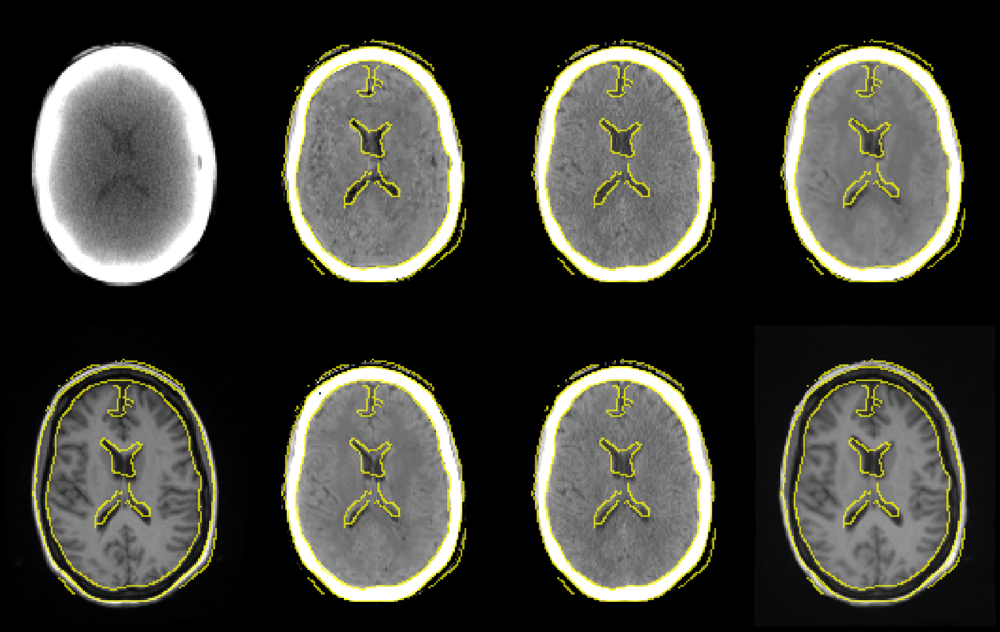

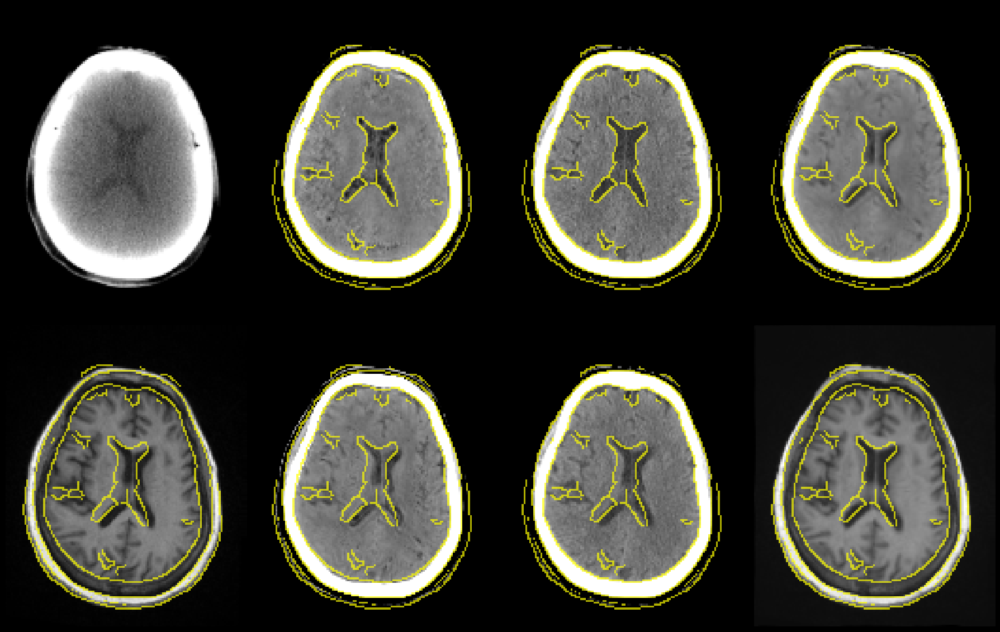

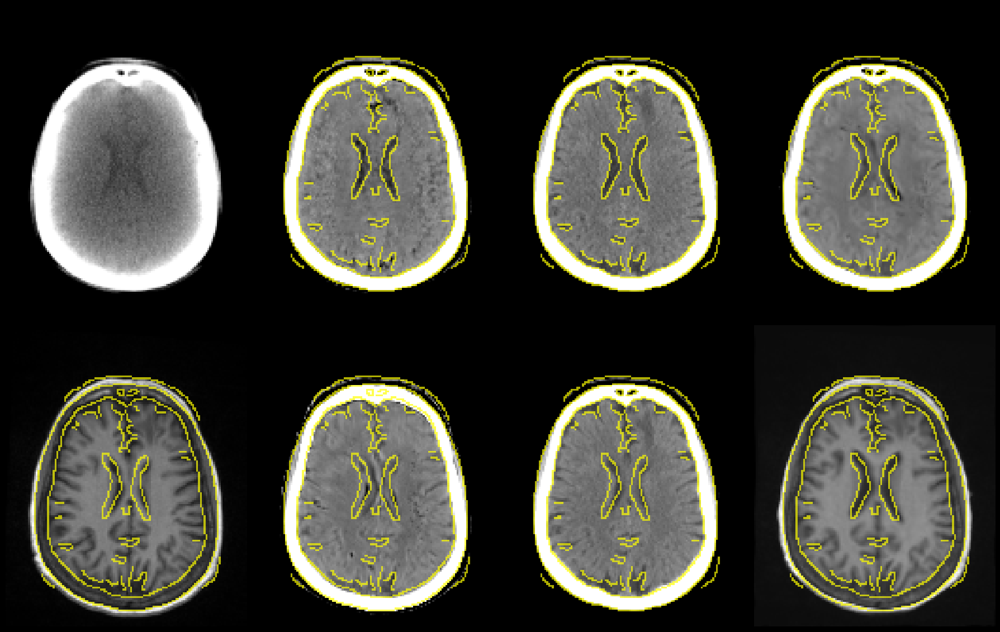

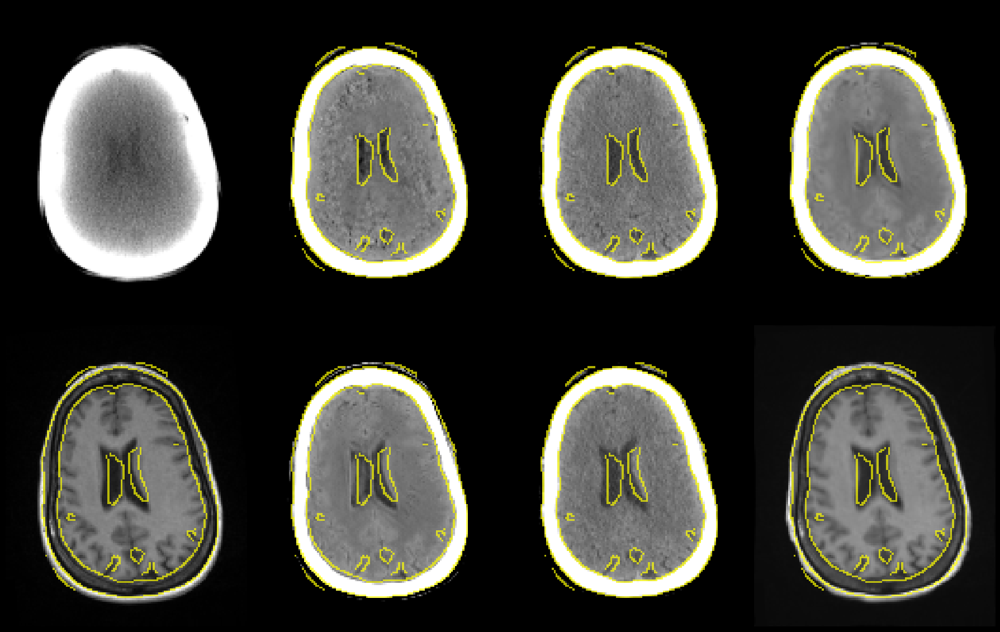

In [5]:
metrics = pd.DataFrame()
mask_val = [1,2,23,5,19,29,8]
G = networks_gan.JSRCascade(separate_decoders=True, res=True, version='v4').to(device)
valid_dataset = RadOncValidationDataset("/mnt/blackhole-data2/RadOnc_Brain/Validation", num_samples=None, supervision=True,
                                            return_segmentation=True)
for ep in range(1):
    checkpoint = torch.load('JSREDL_unclayer_1n0.5_l1100_multi0.3_reg100_seg6_ep99.pt',map_location='cpu')
    G.load_state_dict(checkpoint['G_state_dict'])
    dice_before_total = []
    dice_after_total = []
    hd_before_total = []
    sd_before_total = []
    hd_after_total = []
    sd_after_total = []
    tre_before_total = []
    tre_after_total = []
    
    for i, batch in enumerate(valid_dataset):
        cbct_fixed, mr_moving, ct_fixed, ct_moving, seg_fixed, seg_moving = batch
        cbct_fixed = cbct_fixed.float().to(device)
        mr_moving = mr_moving.float().to(device)
        ct_fixed = ct_fixed.float().to(device)
        ct_moving = ct_moving.float().to(device)
        seg_fixed = seg_fixed.float().to(device)
        seg_moving = seg_moving.float().to(device)

        with torch.no_grad():
            flow, ct_moving_synth, ct_fixed_synth = G(mr_moving, cbct_fixed)

            # the flow[0] means the final highest resolution from the cascade network.
            mr_reg = vxm.layers.SpatialTransformer([128,160,128], mode='bilinear').to(device)(mr_moving, flow[0])
            ct_reg_synth = vxm.layers.SpatialTransformer([128,160,128], mode='bilinear').to(device)(ct_moving_synth[0], flow[0])
            seg_reg = vxm.layers.SpatialTransformer([128,160,128], mode='nearest').to(device)(seg_moving, flow[0])

            dice_before = []
            hd_before = []
            sd_before = []
            dice_after= []
            hd_after = []
            sd_after = []
            for j, val in enumerate(mask_val):
                mask_fixed = seg_fixed[:,j:j+1,:,:,:]
                mask_moving = seg_moving[:,j:j+1,:,:,:]
                mask_registered = seg_reg[:,j:j+1,:,:,:]
                dice_before.append(-losses.Dice().loss(mask_fixed,mask_moving).item())
                dice_after.append(-losses.Dice().loss(mask_fixed,mask_registered).item())
                metrics_before = compute_surface_metrics(np.squeeze(mask_fixed.squeeze().cpu().numpy())==1, np.squeeze(mask_moving.squeeze().cpu().numpy())==1)
                metrics_after = compute_surface_metrics(np.squeeze(mask_fixed.squeeze().cpu().numpy())==1, np.squeeze(mask_registered.squeeze().cpu().numpy())==1)
                hd_before.append(metrics_before['hd'])
                hd_after.append(metrics_after['hd'])
                sd_before.append(metrics_before['avg_dist'])
                sd_after.append(metrics_after['avg_dist'])
                
            valid_ds = np.load(glob.glob(os.path.join("/mnt/blackhole-data2/RadOnc_Brain/Validation",'*.npz'))[i])
            seg_fixed = valid_ds['ventricle_fixed']
            seg_moving = valid_ds['ventricle_moving']
            seg_fixed = torch.from_numpy(resize(seg_fixed, [128,160,128], order=0, anti_aliasing=False)).unsqueeze(0).unsqueeze(0).to(device)
            seg_moving = torch.from_numpy(resize(seg_moving, [128,160,128], order=0, anti_aliasing=False)).unsqueeze(0).unsqueeze(0).to(device)
            seg_reg = vxm.layers.SpatialTransformer([128,160,128], mode='nearest').to(device)(seg_moving, flow[0])
            tre_before_total.append(compute_TRE(seg_fixed.squeeze().cpu().numpy(), seg_moving.squeeze().cpu().numpy(), [1,1,1]).mean())
            tre_after_total.append(compute_TRE(seg_fixed.squeeze().cpu().numpy(), seg_reg.squeeze().cpu().numpy(), [1,1,1]).mean())
            dice_before_total.append(dice_before)
            dice_after_total.append(dice_after)
            hd_before_total.append(hd_before)
            hd_after_total.append(hd_after)
            sd_before_total.append(sd_before)
            sd_after_total.append(sd_after)
            
            islice = 72
            fig, ax = plt.subplots(2,4,figsize=(18,12))
            np.vectorize(lambda ax: ax.axis('off'))(ax)
            ax[0,0].imshow(cbct_fixed.cpu().numpy()[0,0,:,:,islice].T, cmap='gray')
            ax[0,1].imshow(ct_fixed_synth[0].cpu().numpy()[0,0,:,:,islice].T, cmap='gray', vmin=0.4, vmax=0.95)
            ax[0,1].imshow(canny(ct_fixed.cpu().numpy()[:,:,islice].T, sigma=1), cmap=colormap_binary('yellow', alpha=0.7))
            ax[0,2].imshow(ct_fixed.cpu().numpy()[:,:,islice].T, cmap='gray', vmin=0.4, vmax=0.95)
            ax[0,2].imshow(canny(ct_fixed.cpu().numpy()[:,:,islice].T, sigma=1), cmap=colormap_binary('yellow', alpha=0.7))
            ax[0,3].imshow(ct_reg_synth.cpu().numpy()[0,0,:,:,islice].T, cmap='gray', vmin=0.4, vmax=0.95)
            ax[0,3].imshow(canny(ct_fixed.cpu().numpy()[:,:,islice].T, sigma=1), cmap=colormap_binary('yellow', alpha=0.7))

            ax[1,0].imshow(mr_moving.cpu().numpy()[0,0,:,:,islice].T, cmap='gray')
            ax[1,0].imshow(canny(ct_fixed.cpu().numpy()[:,:,islice].T, sigma=1), cmap=colormap_binary('yellow', alpha=0.7))
            ax[1,1].imshow(ct_moving_synth[0].cpu().numpy()[0,0,:,:,islice].T, cmap='gray', vmin=0.4, vmax=0.95)
            ax[1,1].imshow(canny(ct_fixed.cpu().numpy()[:,:,islice].T, sigma=1), cmap=colormap_binary('yellow', alpha=0.7))
            ax[1,2].imshow(ct_moving.cpu().numpy()[:,:,islice].T, cmap='gray', vmin=0.4, vmax=0.95)
            ax[1,2].imshow(canny(ct_fixed.cpu().numpy()[:,:,islice].T, sigma=1), cmap=colormap_binary('yellow', alpha=0.7))
            ax[1,3].imshow(mr_reg.cpu().numpy()[0,0,:,:,islice].T, cmap='gray')
            ax[1,3].imshow(canny(ct_fixed.cpu().numpy()[:,:,islice].T, sigma=1), cmap=colormap_binary('yellow', alpha=0.7))
            plt.tight_layout()
            plt.show()

           
    if ep == 0:
        d0 = {'Dice':np.reshape(np.array(dice_before_total),-1), 'HD':np.reshape(np.array(hd_before_total),-1), 'SD':np.reshape(np.array(sd_before_total),-1), 
              'anatomy':['3rd Ventricle', '4th Ventricle','Lateral Ventricles', 'Amygdala', 'Hippocampus', 'Thalamus', 'Caudate']*10, 'ep':[0]*70, 'method':['Rigid']*70}
        d0 = pd.DataFrame(data=d0)
        metrics = pd.concat([metrics, d0])

    d = {'Dice':np.reshape(np.array(dice_after_total),-1), 'HD':np.reshape(np.array(hd_after_total),-1), 'SD':np.reshape(np.array(sd_after_total),-1), 
         'anatomy':['3rd Ventricle', '4th Ventricle','Lateral Ventricles', 'Amygdala', 'Hippocampus', 'Thalamus', 'Caudate']*10, 'ep':[29+ep*10]*70, 'method':['JSR-Cascade']*70}
    d = pd.DataFrame(data=d)
    metrics = pd.concat([metrics, d])

In [7]:
for name in ['3rd Ventricle', '4th Ventricle','Lateral Ventricles', 'Amygdala', 'Hippocampus', 'Thalamus', 'Caudate']:
    data = metrics[metrics['anatomy']==name]
    data = data[data['method']=='JSR-Cascade']
    Dice = data['Dice'].mean()
    HD = data['HD'].mean()
    SD = data['SD'].mean()
    print(name, Dice, HD, SD)

3rd Ventricle 0.48798622041940687 3.0249586032220437 0.7167552718620172
4th Ventricle 0.46542403399944304 4.309594352132718 0.8683515917107197
Lateral Ventricles 0.7207829475402832 4.358012947282136 0.765037762545993
Amygdala 0.4812231421470642 3.922884729124424 0.8438615546595637
Hippocampus 0.5476525515317917 3.8306302402228796 0.7804734898869995
Thalamus 0.7545401275157928 3.9578423658679247 0.7607631911741819
Caudate 0.5588429272174835 4.208859542620518 0.7128631786112178


In [57]:
for key in data.keys():
    print(key)

cbct_fixed
mr_moving
ct_fixed
ct_moving
seg_fixed
seg_moving


In [58]:
cbct_fixed = data['cbct_fixed']
mr_moving = data['mr_moving']
ct_fixed = data['ct_fixed']
ct_moving = data['ct_moving']
seg_fixed = data['seg_fixed']
seg_moving = data['seg_moving']

In [64]:
for key in data.keys():
    print(data[key].shape)

torch.Size([1, 1, 128, 160, 128])
torch.Size([1, 1, 128, 160, 128])
(128, 160, 128)
(128, 160, 128)
torch.Size([1, 1, 128, 160, 128])
torch.Size([1, 1, 128, 160, 128])


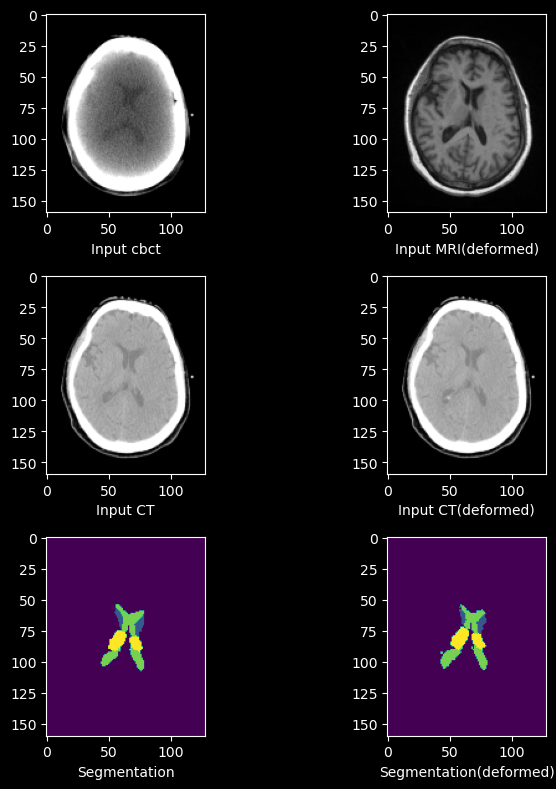

In [76]:
fig, ax = plt.subplots(3,2,figsize=(12,8))
ax[0][0].imshow(cbct_fixed[0,0,:,:,72].T, cmap='gray')
ax[0][0].set_xlabel('Input cbct')
ax[0][1].imshow(mr_moving[0,0,:,:,72].T, cmap='gray')
ax[0][1].set_xlabel('Input MRI(deformed)')

ax[1][0].imshow(ct_fixed[:,:,72].T, cmap='gray')
ax[1][0].set_xlabel('Input CT')
ax[1][1].imshow(ct_moving[:,:,72].T, cmap='gray')
ax[1][1].set_xlabel('Input CT(deformed)')

ax[2][0].imshow(seg_fixed[0,0,:,:,72].T)
ax[2][0].set_xlabel('Segmentation')
ax[2][1].imshow(seg_moving[0,0,:,:,72].T)
ax[2][1].set_xlabel('Segmentation(deformed)')

fig.set_tight_layout(True)
